Atividade 05

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import math

from PIL import Image
from scipy import stats
from skimage.metrics import structural_similarity as ssim
from google.colab.patches import cv2_imshow


from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Imagens

##### Imagens selecionadas

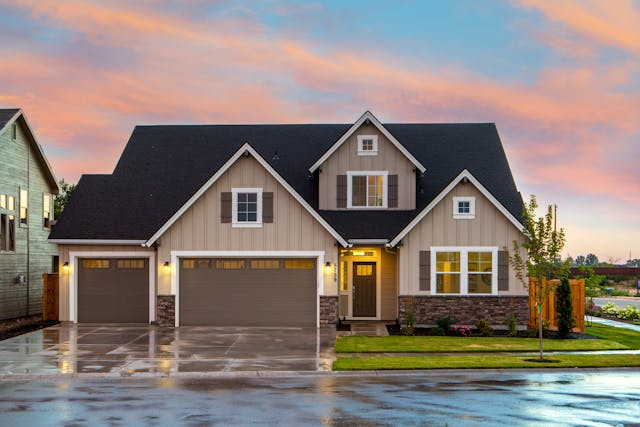

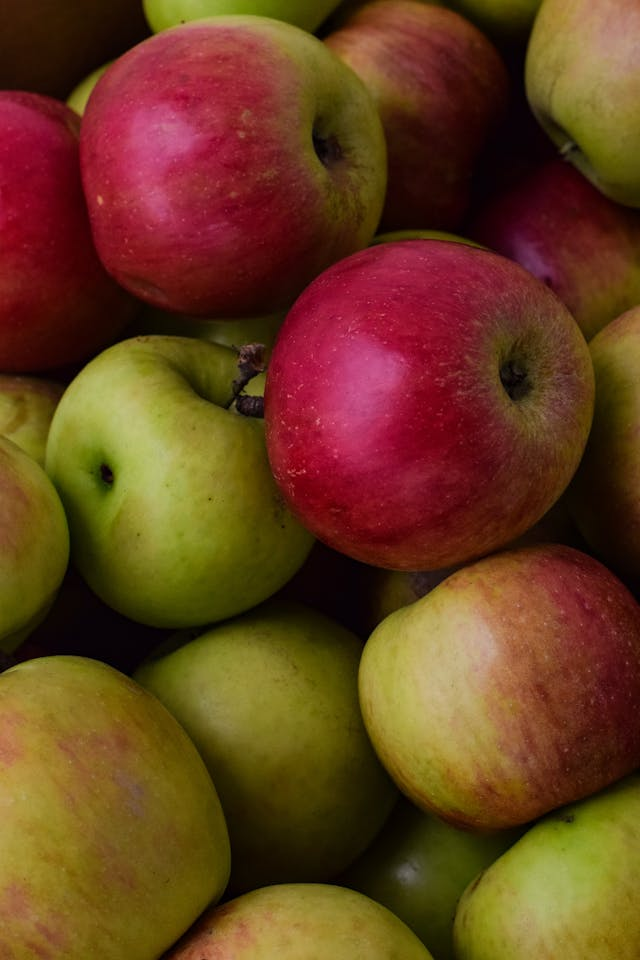

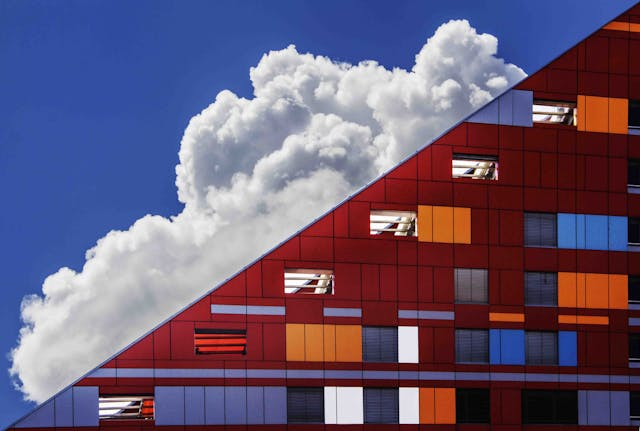

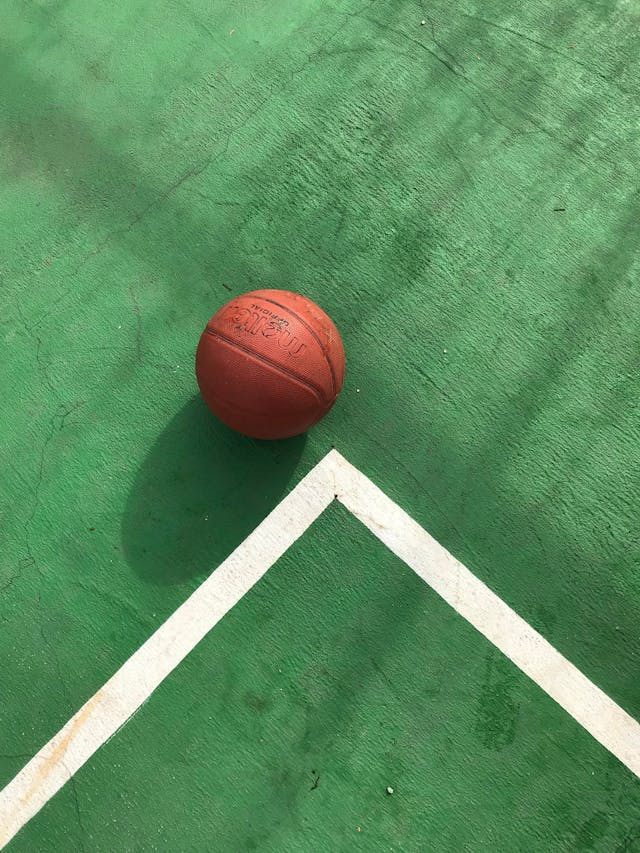

In [4]:
# Lista de caminhos para as quatro imagens
imagens = ['/content/drive/MyDrive/PIM/ATVD05/imag1.jpg',  '/content/drive/MyDrive/PIM/ATVD05/imag2.jpg',  '/content/drive/MyDrive/PIM/ATVD05/imag3.jpg', '/content/drive/MyDrive/PIM/ATVD05/imag4.jpg']

for path in imagens:
    imagem = cv2.imread(path)
    if imagem is not None:
        cv2_imshow(imagem)
    else:
        print(f'Erro ao carregar a imagem {path}.')

##### Informação espacial

In [5]:
img1 =  "/content/drive/MyDrive/PIM/ATVD05/imag1.jpg"


img2 = "/content/drive/MyDrive/PIM/ATVD05/imag2.jpg"


img3 = "/content/drive/MyDrive/PIM/ATVD05/imag3.jpg"


img4 = "/content/drive/MyDrive/PIM/ATVD05/imag4.jpg"



def Inf_spatial(img_grayscale):
    sh = cv2.Sobel (img_grayscale, cv2.CV_64F , 1, 0, ksize =1)
    sv = cv2.Sobel (img_grayscale , cv2.CV_64F , 0, 1, ksize =1)

    #SIr = np.sqrt (sh **2 + sv **2)
    SIr = np.sqrt(np.square(sh) + np.square(sv))

    SI_mean = np.sum(SIr ) / (SIr. shape [0] * SIr . shape [1])
    SI_rms = np.sqrt (np.sum (SIr **2) / (SIr. shape [0] * SIr . shape [1]) )
    SI_stdev = np.sqrt (np.sum(SIr **2 - SI_mean **2) / (SIr. shape [0] *SIr. shape [1]) )

    return SI_stdev

imag_1 = cv2.imread(img1)

imag_2 = cv2.imread(img2)

imag_3 = cv2.imread(img3)

imag_4 = cv2.imread(img4)

imgGrey1 = cv2.cvtColor(imag_1,cv2.COLOR_BGR2GRAY)
imgGrey2 = cv2.cvtColor(imag_2,cv2.COLOR_BGR2GRAY)
imgGrey3 = cv2.cvtColor(imag_3,cv2.COLOR_BGR2GRAY)
imgGrey4 = cv2.cvtColor(imag_4,cv2.COLOR_BGR2GRAY)


SI = Inf_spatial(imgGrey1)
SI2 = Inf_spatial(imgGrey2)
SI3 = Inf_spatial(imgGrey3)
SI4 = Inf_spatial(imgGrey4)


print ("Informação espacial 1 : %f" % SI )
print ("Informação espacial 2 : %f" % SI2 )
print ("Informação espacial 3 : %f" % SI3 )
print ("Informação espacial 4 : %f" % SI4 )

Informação espacial 1 : 27.858018
Informação espacial 2 : 6.284310
Informação espacial 3 : 23.083803
Informação espacial 4 : 19.610376


##### Imagens em cinza

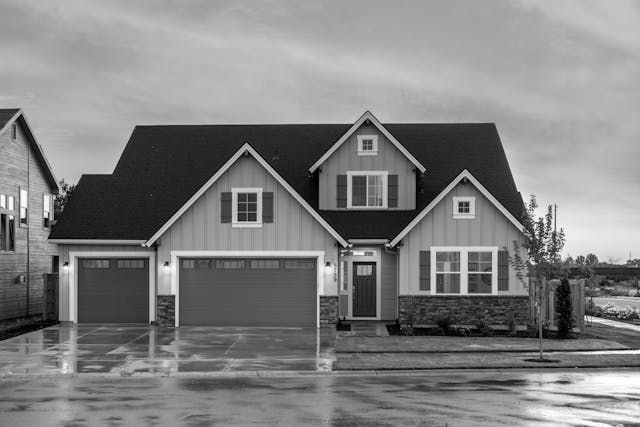

Nome da imagem: imagem 1
Tamanho da imagem: 427x640



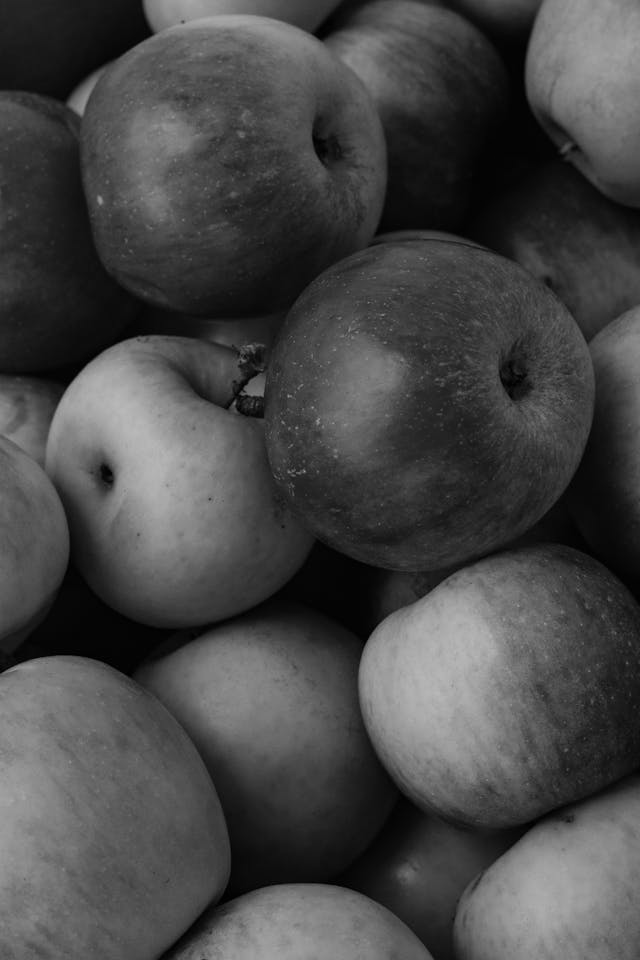

Nome da imagem: imagem 2
Tamanho da imagem: 960x640



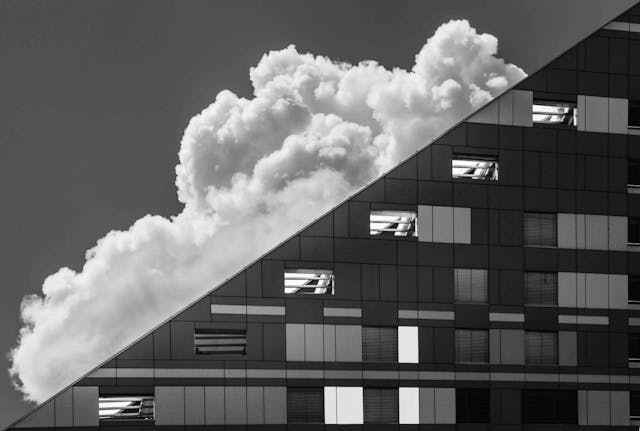

Nome da imagem: imagem 3
Tamanho da imagem: 431x640



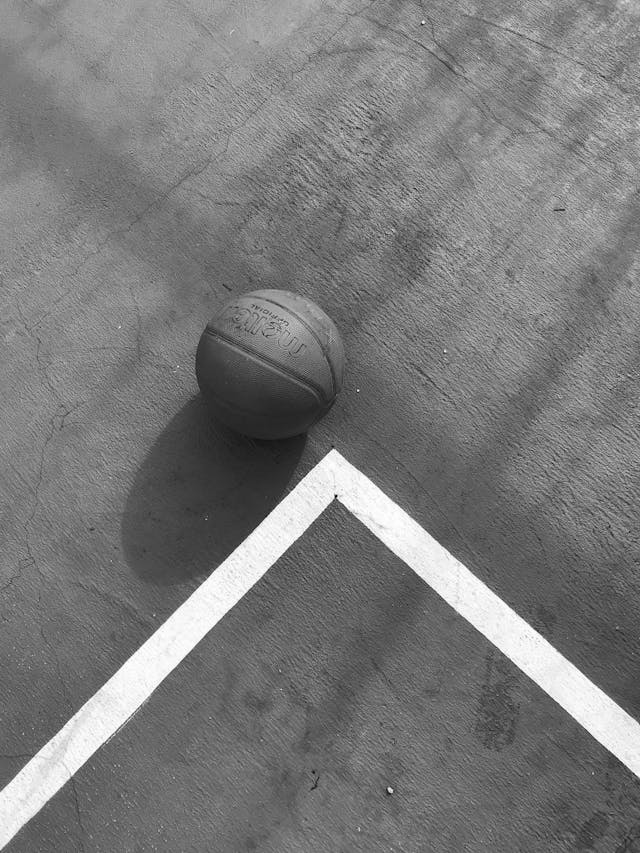

Nome da imagem: imagem 4
Tamanho da imagem: 853x640



In [52]:
imagens_cinza = [
    (imgGrey1, "imagem 1"),
    (imgGrey2, "imagem 2"),
    (imgGrey3, "imagem 3"),
    (imgGrey4, "imagem 4")
]

for imagem, nome in imagens_cinza:
    cv2_imshow(imagem)
    altura, largura = imagem.shape[::-1]
    print(f'Nome da imagem: {nome}')
    print(f'Tamanho da imagem: {largura}x{altura}\n')


##### Histograma de cada imagem

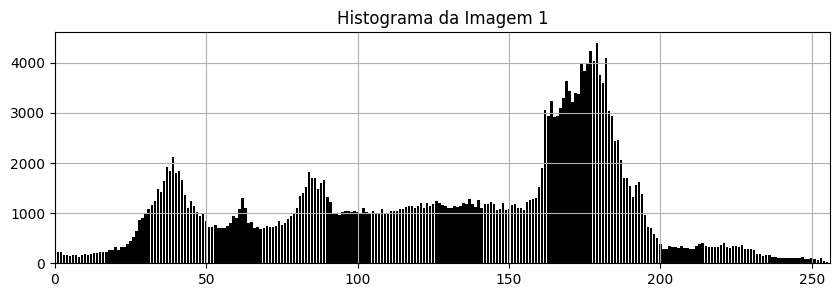

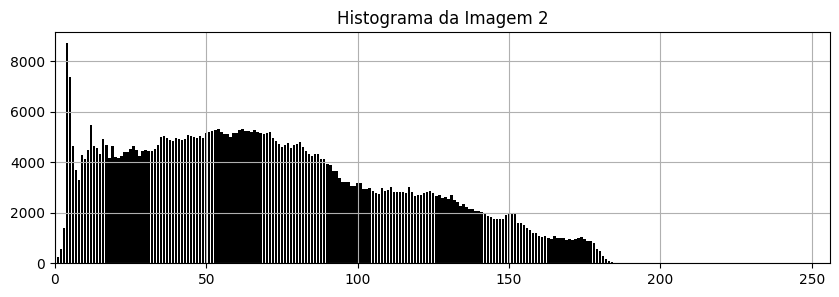

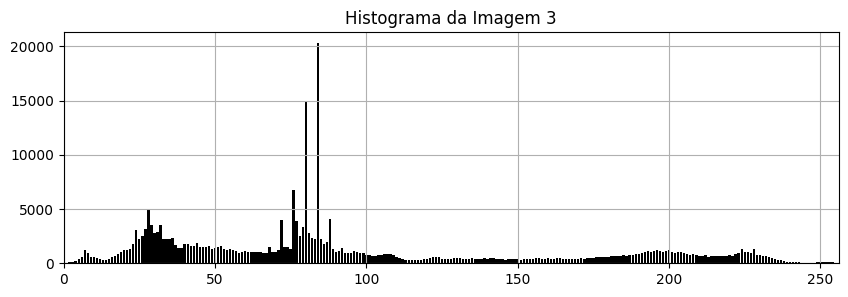

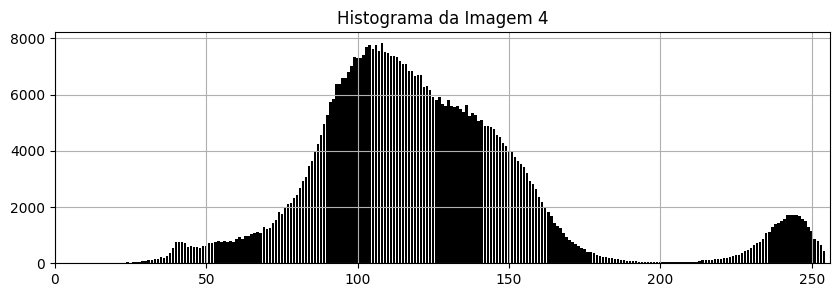

In [ ]:
def histograma(imagem):
    histogram, _ = np.histogram(imagem.flatten(), bins=256, range=(0,256))
    return histogram

hist_1 = histograma(imgGrey1)
plt.figure(figsize=(10, 3))
plt.title("Histograma da Imagem 1")
plt.bar(np.arange(256), hist_1, color='black')
plt.xlim([0, 256])
plt.grid(True)

hist_2 = histograma(imgGrey2)
plt.figure(figsize=(10, 3))
plt.title("Histograma da Imagem 2")
plt.bar(np.arange(256), hist_2, color='black')
plt.xlim([0, 256])
plt.grid(True)

hist_3 = histograma(imgGrey3)
plt.figure(figsize=(10, 3))
plt.title("Histograma da Imagem 3")
plt.bar(np.arange(256), hist_3, color='black')
plt.xlim([0, 256])
plt.grid(True)


hist_4 = histograma(imgGrey4)
plt.figure(figsize=(10, 3))
plt.title("Histograma da Imagem 4")
plt.bar(np.arange(256), hist_4, color='black')
plt.xlim([0, 256])
plt.grid(True)



##### Limiares

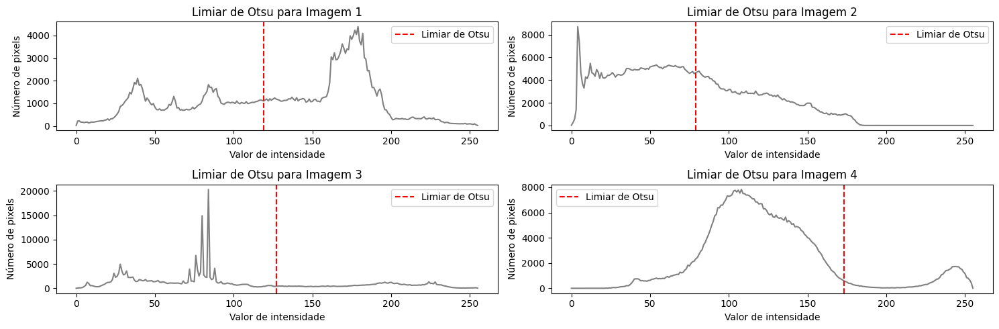

Imagem 1 - Limiar:  119.0
Imagem 2 - Limiar:  79.0
Imagem 3 - Limiar:  127.0
Imagem 4 - Limiar:  173.0


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# imgGrey1
histograma1 = cv2.calcHist([imgGrey1], [0], None, [256], [0, 256])
histograma1 = np.squeeze(histograma1)
limiar1, _ = cv2.threshold(imgGrey1, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
plt.figure(figsize=(15, 5))
plt.subplot(2, 2, 1)
plt.plot(histograma1, color='gray')
plt.axvline(x=limiar1, color='red', linestyle='--', label='Limiar de Otsu')
plt.xlabel('Valor de intensidade')
plt.ylabel('Número de pixels')
plt.title('Limiar de Otsu para Imagem 1')
plt.legend()

# imgGrey2
histograma2 = cv2.calcHist([imgGrey2], [0], None, [256], [0, 256])
histograma2 = np.squeeze(histograma2)
limiar2, _ = cv2.threshold(imgGrey2, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
plt.subplot(2, 2, 2)
plt.plot(histograma2, color='gray')
plt.axvline(x=limiar2, color='red', linestyle='--', label='Limiar de Otsu')
plt.xlabel('Valor de intensidade')
plt.ylabel('Número de pixels')
plt.title('Limiar de Otsu para Imagem 2')
plt.legend()

# imgGrey3
histograma3 = cv2.calcHist([imgGrey3], [0], None, [256], [0, 256])
histograma3 = np.squeeze(histograma3)
limiar3, _ = cv2.threshold(imgGrey3, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
plt.subplot(2, 2, 3)
plt.plot(histograma3, color='gray')
plt.axvline(x=limiar3, color='red', linestyle='--', label='Limiar de Otsu')
plt.xlabel('Valor de intensidade')
plt.ylabel('Número de pixels')
plt.title('Limiar de Otsu para Imagem 3')
plt.legend()

# imgGrey4
histograma4 = cv2.calcHist([imgGrey4], [0], None, [256], [0, 256])
histograma4 = np.squeeze(histograma4)
limiar4, _ = cv2.threshold(imgGrey4, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
plt.subplot(2, 2, 4)
plt.plot(histograma4, color='gray')
plt.axvline(x=limiar4, color='red', linestyle='--', label='Limiar de Otsu')
plt.xlabel('Valor de intensidade')
plt.ylabel('Número de pixels')
plt.title('Limiar de Otsu para Imagem 4')
plt.legend(loc='upper left')

plt.tight_layout()
plt.show()

print("Imagem 1 - Limiar: ", limiar1)
print("Imagem 2 - Limiar: ", limiar2)
print("Imagem 3 - Limiar: ", limiar3)
print("Imagem 4 - Limiar: ", limiar4)

## 1- Identificar as bordas usando os métodos de Sobel, Roberts, Prewitlaplaciano e canny (apresentar também a identificação das linhas verticais e horizontais), usando filtro da média e sem o filtro da média

### Imagem 1

#### Método Sobel

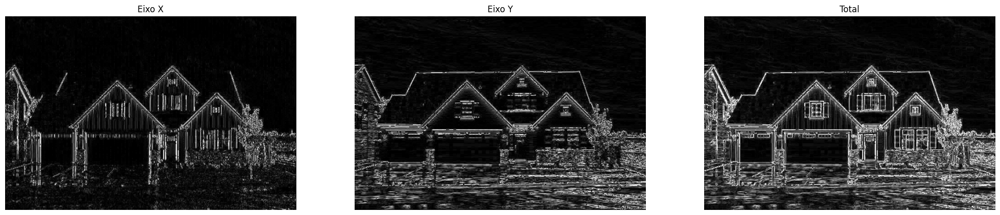

In [ ]:
sobel_x = cv2.Sobel(imgGrey1, cv2.CV_64F, 1, 0, ksize=3)
sobel_y = cv2.Sobel(imgGrey1, cv2.CV_64F, 0, 1, ksize=3)
sobelx = np.uint8(np.absolute(sobel_x))
sobely = np.uint8(np.absolute(sobel_y))
imagem_sobel = cv2.bitwise_or(sobelx, sobely)

'''cv2_imshow(sobel_x)
cv2_imshow(sobel_y)
cv2_imshow(imagem_sobel)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(sobelx, cmap='gray')
axes[0].set_title('Eixo X')
axes[1].imshow(sobely, cmap='gray')
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_sobel, cmap='gray')
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

Filtro da média

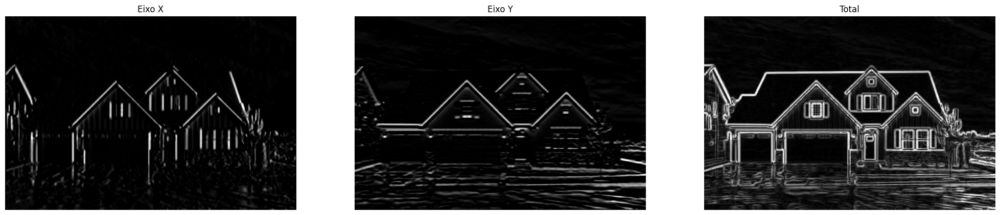

In [ ]:
imagem_media = cv2.blur(imgGrey1, (5, 5))

sobel_x_media = cv2.Sobel(imagem_media, cv2.CV_64F, 1, 0, ksize=3)
sobel_y_media = cv2.Sobel(imagem_media, cv2.CV_64F, 0, 1, ksize=3)
sobelx_media = np.uint8(np.absolute(sobel_x_media))
sobely_media = np.uint8(np.absolute(sobel_y_media))
imagem_sobel_media = cv2.bitwise_or(sobelx_media, sobely_media)

'''cv2_imshow(sobel_x_media)
cv2_imshow(sobel_y_media)
cv2_imshow(imagem_sobel_media)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(sobel_x_media, cmap='gray', vmin=0, vmax=255)
axes[0].set_title('Eixo X')
axes[1].imshow(sobel_y_media, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_sobel_media, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()



#### Método Roberts

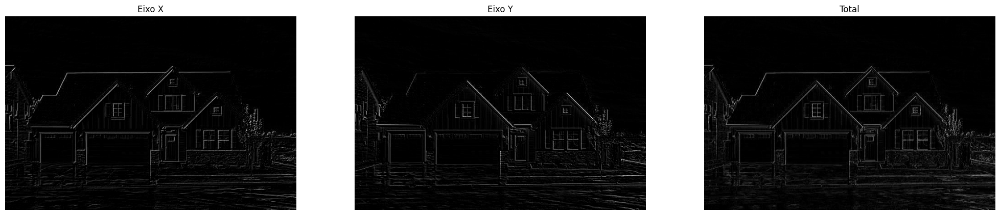

In [ ]:
roberts_x_1 = np.array([[1, 0], [0, -1]])
roberts_y_1 = np.array([[0, -1], [1, 0]])

roberts_x = cv2.filter2D(imgGrey1, -1, roberts_x_1)
roberts_y = cv2.filter2D(imgGrey1, -1, roberts_y_1)
robertsx = np.uint8(np.absolute(roberts_x))
robertsy= np.uint8(np.absolute(roberts_y))
imagem_roberts = cv2.bitwise_or(robertsx, robertsy)

'''cv2_imshow(roberts_x)
cv2_imshow(roberts_y)
cv2_imshow(imagem_roberts)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(robertsx, cmap='gray')
axes[0].set_title('Eixo X')
axes[1].imshow(robertsy, cmap='gray')
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_roberts, cmap='gray')
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

Filtro da média

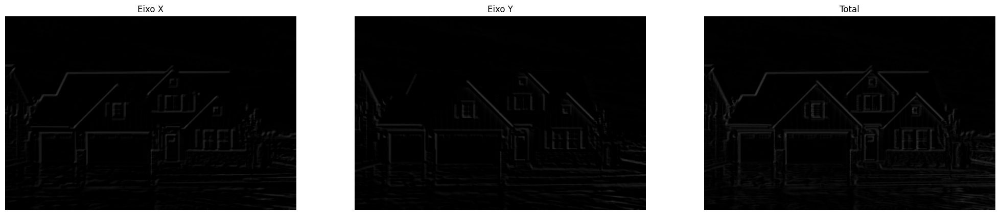

In [ ]:
imagem_media = cv2.blur(imgGrey1, (5, 5))
roberts_x_media = cv2.filter2D(imagem_media, -1, roberts_x_1)
roberts_y_media = cv2.filter2D(imagem_media, -1, roberts_y_1)
robertsx_media = np.uint8(np.absolute(roberts_x_media))
robertsy_media= np.uint8(np.absolute(roberts_y_media))
imagem_roberts_media = cv2.bitwise_or(robertsx_media, robertsy_media)


'''cv2_imshow(roberts_x_media)
cv2_imshow(roberts_y_media)
cv2_imshow(imagem_roberts_media)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(roberts_x_media, cmap='gray', vmin=0, vmax=255)
axes[0].set_title('Eixo X')
axes[1].imshow(roberts_y_media, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_roberts_media, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

#### Método Prewit

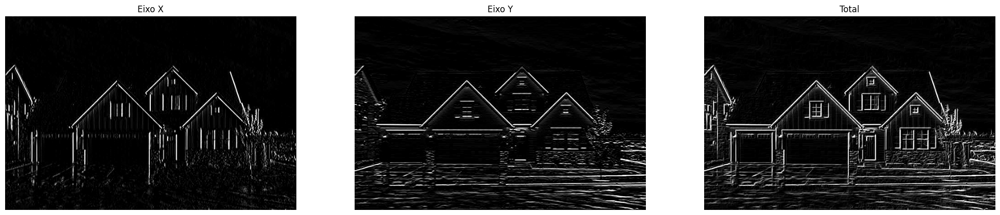

In [ ]:
prewitt_x = cv2.filter2D(imgGrey1, -1, np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]]))
prewitt_y = cv2.filter2D(imgGrey1, -1, np.array([[-1, -1, -1], [0, 0, 0], [1, 1, 1]]))
prewittx = np.uint8(np.absolute(prewitt_x))
prewitty= np.uint8(np.absolute(prewitt_y))
imagem_prewitt= cv2.bitwise_or(prewittx, prewitty)

'''cv2_imshow(prewitt_x)
cv2_imshow(prewitt_y)
cv2_imshow(imagem_prewitt)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(prewitt_x, cmap='gray')
axes[0].set_title('Eixo X')
axes[1].imshow(prewitt_y, cmap='gray')
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_prewitt, cmap='gray')
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()


Filtro da média

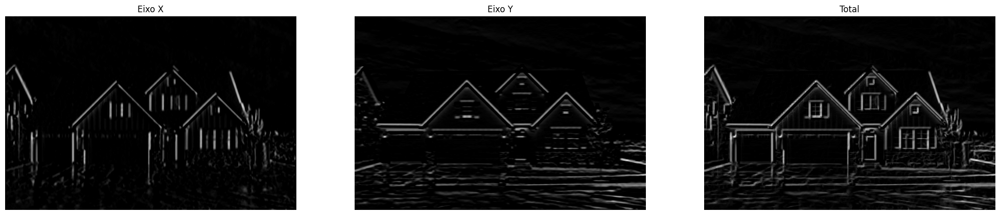

In [ ]:
imagem_media = cv2.blur(imgGrey1, (5, 5))
prewitt_x_media = cv2.filter2D(imagem_media, -1, np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]]))
prewitt_y_media = cv2.filter2D(imagem_media, -1, np.array([[-1, -1, -1], [0, 0, 0], [1, 1, 1]]))
prewittx_media = np.uint8(np.absolute(prewitt_x_media))
prewitty_media = np.uint8(np.absolute(prewitt_y_media))
imagem_prewitt_media = cv2.bitwise_or(prewittx_media, prewitty_media)


'''cv2_imshow(prewitt_x_media)
cv2_imshow(prewitt_y_media)
cv2_imshow(imagem_prewitt_media)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(prewitt_x_media, cmap='gray', vmin=0, vmax=255)
axes[0].set_title('Eixo X')
axes[1].imshow(prewitt_y_media, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_prewitt_media, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

#### Método Laplaciano

In [ ]:
imagem_laplaciano = cv2.Laplacian(imgGrey1, cv2.CV_64F)
#cv2_imshow(imagem_laplaciano)

Filtro da média

In [ ]:
imagem_media = cv2.blur(imgGrey1, (5, 5))
imagem_laplaciano_media = cv2.Laplacian(imagem_media, cv2.CV_64F)
#cv2_imshow(imagem_laplaciano_media)

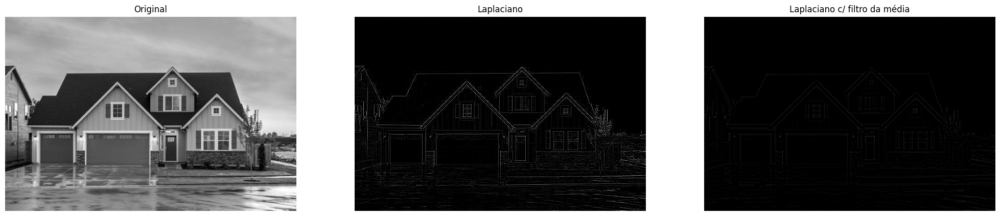

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(imgGrey1, cmap='gray')
axes[0].set_title('Original')
axes[1].imshow(imagem_laplaciano, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Laplaciano')
axes[2].imshow(imagem_laplaciano_media, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Laplaciano c/ filtro da média')
for ax in axes:
    ax.axis('off')

plt.show()

#### Método Canny

In [ ]:
imagem_canny = cv2.Canny(imgGrey1, 119, 200)
#cv2_imshow(imagem_canny)

Filtro da média

In [ ]:
imagem_media = cv2.blur(imgGrey1, (5, 5))

imagem_canny_media = cv2.Canny(imagem_media, 60, 200)
#cv2_imshow(imagem_canny_media)

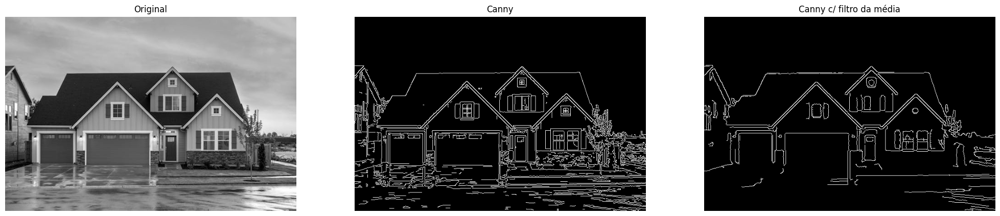

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(imgGrey1, cmap='gray')
axes[0].set_title('Original')
axes[1].imshow(imagem_canny, cmap='gray')
axes[1].set_title('Canny')
axes[2].imshow(imagem_canny_media, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Canny c/ filtro da média')
for ax in axes:
    ax.axis('off')

plt.show()

### Imagem 2

#### Método Sobel

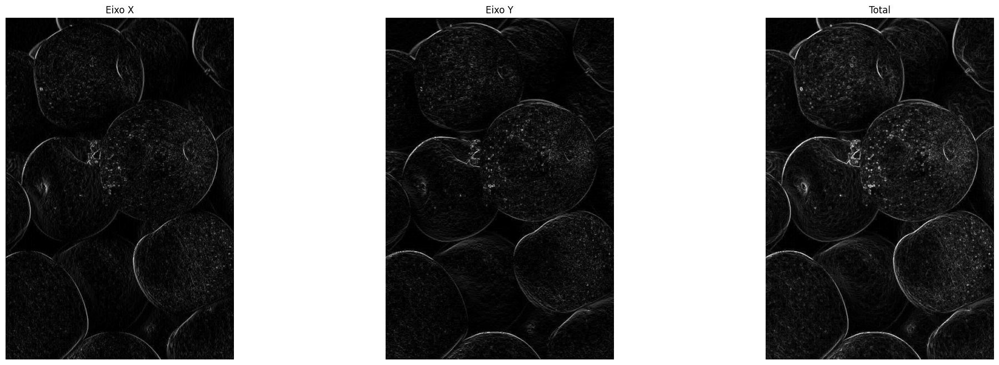

In [ ]:
sobel_x = cv2.Sobel(imgGrey2, cv2.CV_64F, 1, 0, ksize=3)
sobel_y = cv2.Sobel(imgGrey2, cv2.CV_64F, 0, 1, ksize=3)
sobelx = np.uint8(np.absolute(sobel_x))
sobely = np.uint8(np.absolute(sobel_y))
imagem_sobel2 = cv2.bitwise_or(sobelx, sobely)

'''cv2_imshow(sobel_x)
cv2_imshow(sobel_y)
cv2_imshow(imagem_sobel2)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(sobelx, cmap='gray')
axes[0].set_title('Eixo X')
axes[1].imshow(sobely, cmap='gray')
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_sobel2, cmap='gray')
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

Filtro da média

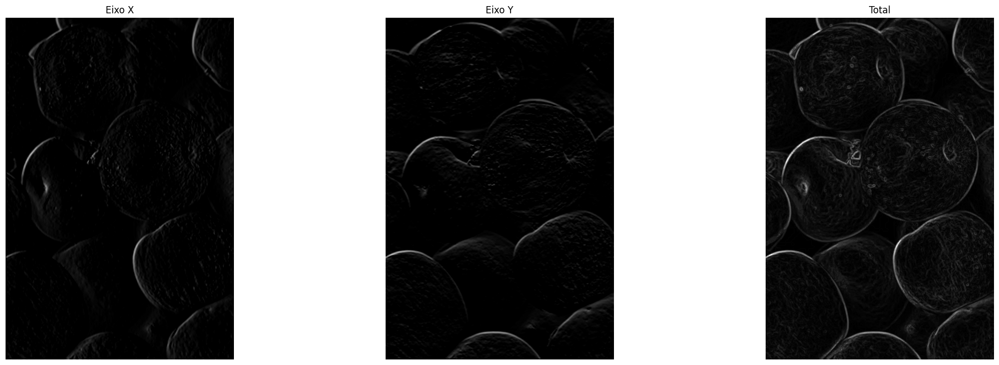

In [ ]:
imagem_media2 = cv2.blur(imgGrey2, (5, 5))

sobel_x_media = cv2.Sobel(imagem_media2, cv2.CV_64F, 1, 0, ksize=3)
sobel_y_media = cv2.Sobel(imagem_media2, cv2.CV_64F, 0, 1, ksize=3)
sobelx_media = np.uint8(np.absolute(sobel_x_media))
sobely_media = np.uint8(np.absolute(sobel_y_media))
imagem_sobel_media2 = cv2.bitwise_or(sobelx_media, sobely_media)

''' cv2_imshow(sobel_x_media)
cv2_imshow(sobel_y_media)
cv2_imshow(imagem_sobel_media2) '''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(sobel_x_media, cmap='gray', vmin=0, vmax=255)
axes[0].set_title('Eixo X')
axes[1].imshow(sobel_y_media, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_sobel_media2, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

#### Método Robert

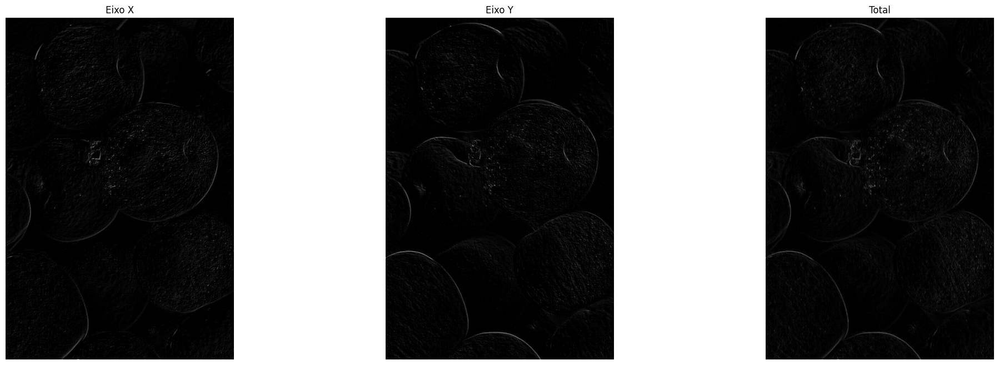

In [ ]:
roberts_x_1 = np.array([[1, 0], [0, -1]])
roberts_y_1 = np.array([[0, -1], [1, 0]])

roberts_x = cv2.filter2D(imgGrey2, -1, roberts_x_1)
roberts_y = cv2.filter2D(imgGrey2, -1, roberts_y_1)
robertsx = np.uint8(np.absolute(roberts_x))
robertsy= np.uint8(np.absolute(roberts_y))
imagem_roberts2 = cv2.bitwise_or(robertsx, robertsy)

'''cv2_imshow(roberts_x)
cv2_imshow(roberts_y)
cv2_imshow(imagem_roberts2)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(robertsx, cmap='gray')
axes[0].set_title('Eixo X')
axes[1].imshow(robertsy, cmap='gray')
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_roberts2, cmap='gray')
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

Filtro da média

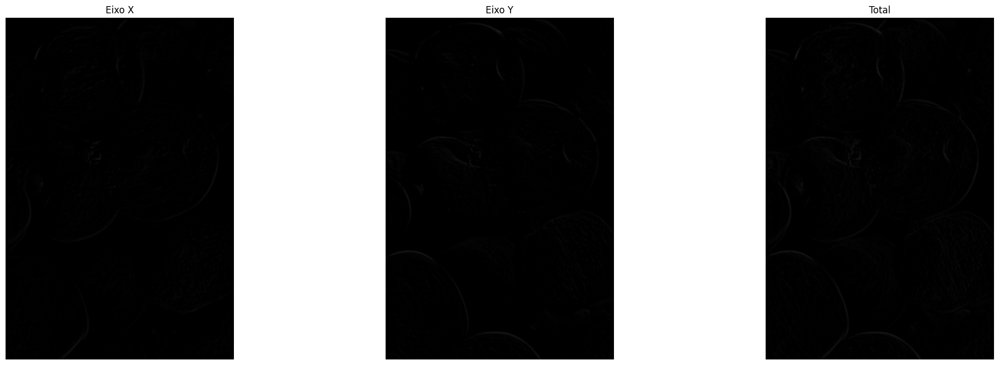

In [ ]:
imagem_media2 = cv2.blur(imgGrey2, (5, 5))
roberts_x_media = cv2.filter2D(imagem_media2, -1, roberts_x_1)
roberts_y_media = cv2.filter2D(imagem_media2, -1, roberts_y_1)
robertsx_media = np.uint8(np.absolute(roberts_x_media))
robertsy_media= np.uint8(np.absolute(roberts_y_media))
imagem_roberts_media2 = cv2.bitwise_or(robertsx_media, robertsy_media)


'''cv2_imshow(roberts_x_media)
cv2_imshow(roberts_y_media)
cv2_imshow(imagem_roberts_media2)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(roberts_x_media, cmap='gray', vmin=0, vmax=255)
axes[0].set_title('Eixo X')
axes[1].imshow(roberts_y_media, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_roberts_media2, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

#### Método Prewit

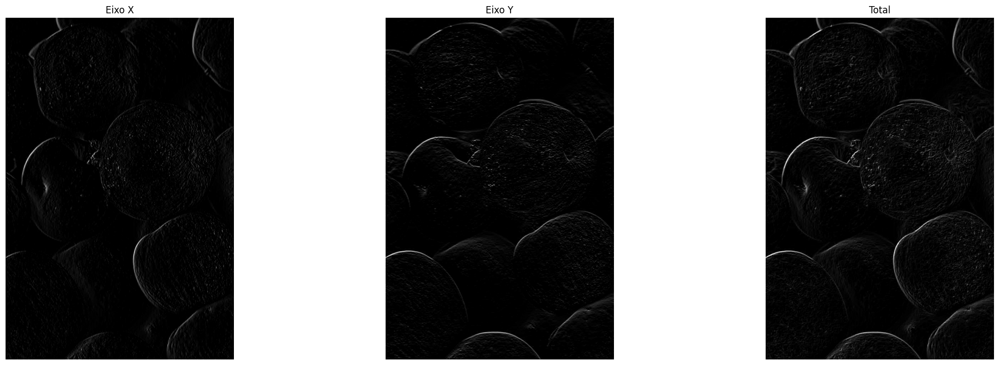

In [ ]:
prewitt_x = cv2.filter2D(imgGrey2, -1, np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]]))
prewitt_y = cv2.filter2D(imgGrey2, -1, np.array([[-1, -1, -1], [0, 0, 0], [1, 1, 1]]))
prewittx = np.uint8(np.absolute(prewitt_x))
prewitty= np.uint8(np.absolute(prewitt_y))
imagem_prewitt2= cv2.bitwise_or(prewittx, prewitty)

'''cv2_imshow(prewitt_x)
cv2_imshow(prewitt_y)
cv2_imshow(imagem_prewitt2)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(prewitt_x, cmap='gray')
axes[0].set_title('Eixo X')
axes[1].imshow(prewitt_y, cmap='gray')
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_prewitt2, cmap='gray')
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

Filtro da média

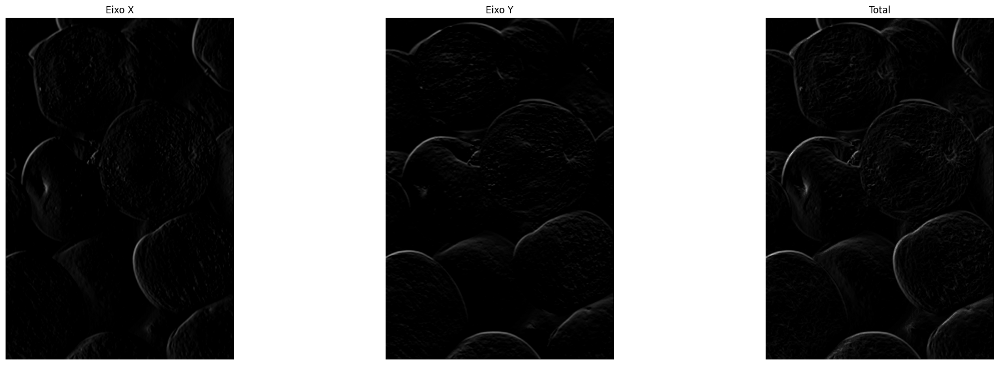

In [ ]:
imagem_media2 = cv2.blur(imgGrey2, (5, 5))
prewitt_x_media = cv2.filter2D(imagem_media2, -1, np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]]))
prewitt_y_media = cv2.filter2D(imagem_media2, -1, np.array([[-1, -1, -1], [0, 0, 0], [1, 1, 1]]))
prewittx_media = np.uint8(np.absolute(prewitt_x_media))
prewitty_media = np.uint8(np.absolute(prewitt_y_media))
imagem_prewitt_media2 = cv2.bitwise_or(prewittx_media, prewitty_media)


'''cv2_imshow(prewitt_x_media)
cv2_imshow(prewitt_y_media)
cv2_imshow(imagem_prewitt_media2)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(prewitt_x_media, cmap='gray', vmin=0, vmax=255)
axes[0].set_title('Eixo X')
axes[1].imshow(prewitt_y_media, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_prewitt_media2, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

#### Método Laplaciano

In [ ]:
imagem_laplaciano2 = cv2.Laplacian(imgGrey2, cv2.CV_64F)
#cv2_imshow(imagem_laplaciano2)

Filtro da média

In [ ]:
imagem_media2 = cv2.blur(imgGrey2, (5, 5))
imagem_laplaciano_media2 = cv2.Laplacian(imagem_media2, cv2.CV_64F)
#cv2_imshow(imagem_laplaciano_media2)

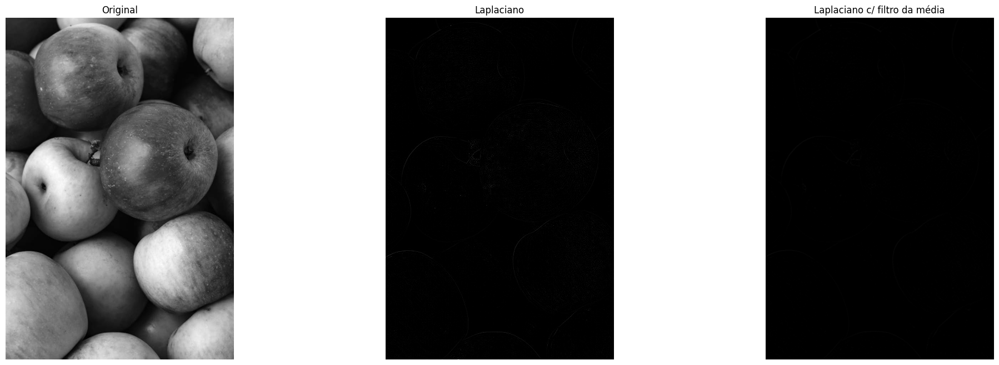

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(imgGrey2, cmap='gray')
axes[0].set_title('Original')
axes[1].imshow(imagem_laplaciano2, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Laplaciano')
axes[2].imshow(imagem_laplaciano_media2, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Laplaciano c/ filtro da média')
for ax in axes:
    ax.axis('off')

plt.show()

#### Método Canny

In [ ]:
imagem_canny2 = cv2.Canny(imgGrey2, 20, 40)
#cv2_imshow(imagem_canny2)

Filtro da média

In [ ]:
imagem_media2 = cv2.blur(imgGrey2, (5, 5))

imagem_canny_media2 = cv2.Canny(imagem_media2, 20, 40)
#cv2_imshow(imagem_canny_media2)

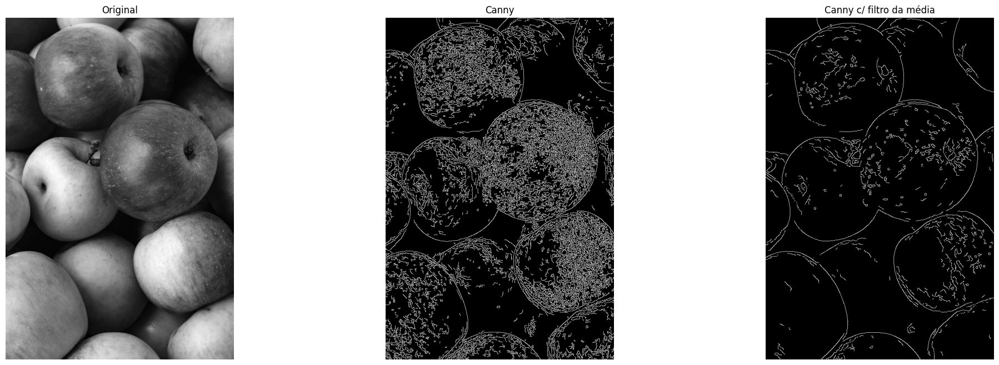

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(imgGrey2, cmap='gray')
axes[0].set_title('Original')
axes[1].imshow(imagem_canny2, cmap='gray')
axes[1].set_title('Canny')
axes[2].imshow(imagem_canny_media2, cmap='gray')
axes[2].set_title('Canny c/ filtro da média')
for ax in axes:
    ax.axis('off')

plt.show()

### Imagem 3

#### Método Sobel

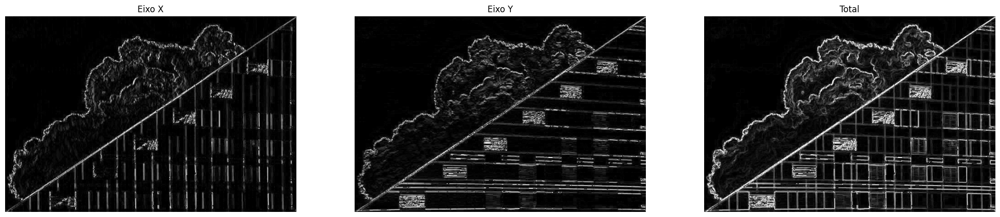

In [ ]:
sobel_x = cv2.Sobel(imgGrey3, cv2.CV_64F, 1, 0, ksize=3)
sobel_y = cv2.Sobel(imgGrey3, cv2.CV_64F, 0, 1, ksize=3)
sobelx = np.uint8(np.absolute(sobel_x))
sobely = np.uint8(np.absolute(sobel_y))
imagem_sobel3 = cv2.bitwise_or(sobelx, sobely)

'''cv2_imshow(sobel_x)
cv2_imshow(sobel_y)
cv2_imshow(imagem_sobel3)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(sobelx, cmap='gray')
axes[0].set_title('Eixo X')
axes[1].imshow(sobely, cmap='gray')
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_sobel3, cmap='gray')
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

Filtro da média

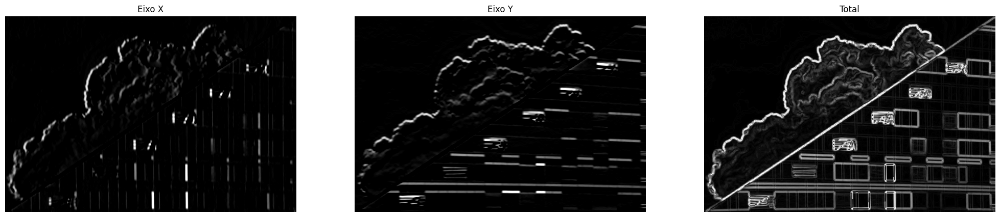

In [ ]:
imagem_media3 = cv2.blur(imgGrey3, (5, 5))

sobel_x_media = cv2.Sobel(imagem_media3, cv2.CV_64F, 1, 0, ksize=3)
sobel_y_media = cv2.Sobel(imagem_media3, cv2.CV_64F, 0, 1, ksize=3)
sobelx_media = np.uint8(np.absolute(sobel_x_media))
sobely_media = np.uint8(np.absolute(sobel_y_media))
imagem_sobel_media3 = cv2.bitwise_or(sobelx_media, sobely_media)

''' cv2_imshow(sobel_x_media)
cv2_imshow(sobel_y_media)
cv2_imshow(imagem_sobel_media2) '''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(sobel_x_media, cmap='gray', vmin=0, vmax=255)
axes[0].set_title('Eixo X')
axes[1].imshow(sobel_y_media, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_sobel_media3, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

#### Método Robert

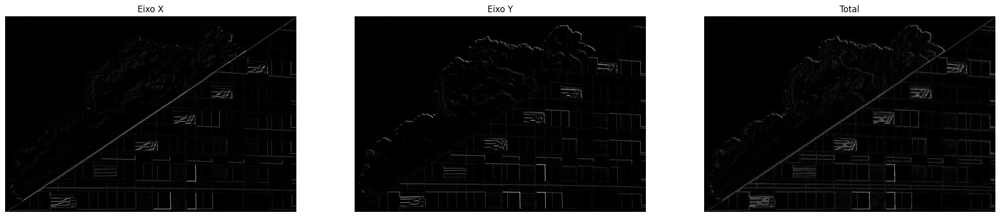

In [ ]:
roberts_x_1 = np.array([[1, 0], [0, -1]])
roberts_y_1 = np.array([[0, -1], [1, 0]])

roberts_x = cv2.filter2D(imgGrey3, -1, roberts_x_1)
roberts_y = cv2.filter2D(imgGrey3, -1, roberts_y_1)
robertsx = np.uint8(np.absolute(roberts_x))
robertsy= np.uint8(np.absolute(roberts_y))
imagem_roberts3 = cv2.bitwise_or(robertsx, robertsy)

'''cv2_imshow(roberts_x)
cv2_imshow(roberts_y)
cv2_imshow(imagem_roberts3)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(robertsx, cmap='gray')
axes[0].set_title('Eixo X')
axes[1].imshow(robertsy, cmap='gray')
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_roberts3, cmap='gray')
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

Filtro da média

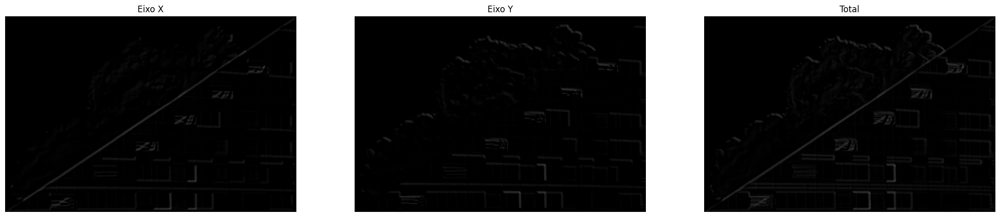

In [ ]:
imagem_media3 = cv2.blur(imgGrey3, (5, 5))
roberts_x_media = cv2.filter2D(imagem_media3, -1, roberts_x_1)
roberts_y_media = cv2.filter2D(imagem_media3, -1, roberts_y_1)
robertsx_media = np.uint8(np.absolute(roberts_x_media))
robertsy_media= np.uint8(np.absolute(roberts_y_media))
imagem_roberts_media3 = cv2.bitwise_or(robertsx_media, robertsy_media)


'''cv2_imshow(roberts_x_media)
cv2_imshow(roberts_y_media)
cv2_imshow(imagem_roberts_media3)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(roberts_x_media, cmap='gray', vmin=0, vmax=255)
axes[0].set_title('Eixo X')
axes[1].imshow(roberts_y_media, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_roberts_media3, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

#### Método Prewit

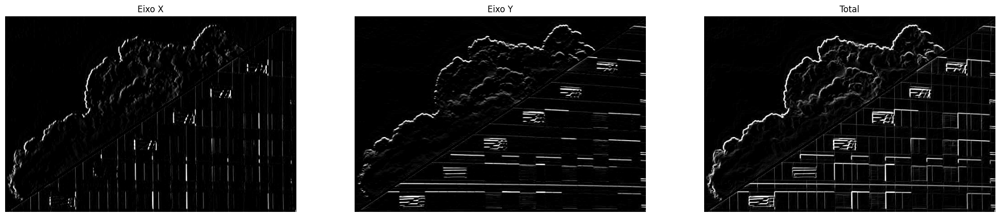

In [ ]:
prewitt_x = cv2.filter2D(imgGrey3, -1, np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]]))
prewitt_y = cv2.filter2D(imgGrey3, -1, np.array([[-1, -1, -1], [0, 0, 0], [1, 1, 1]]))
prewittx = np.uint8(np.absolute(prewitt_x))
prewitty= np.uint8(np.absolute(prewitt_y))
imagem_prewitt3= cv2.bitwise_or(prewittx, prewitty)

'''cv2_imshow(prewitt_x)
cv2_imshow(prewitt_y)
cv2_imshow(imagem_prewitt3)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(prewitt_x, cmap='gray')
axes[0].set_title('Eixo X')
axes[1].imshow(prewitt_y, cmap='gray')
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_prewitt3, cmap='gray')
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

Filtro da média

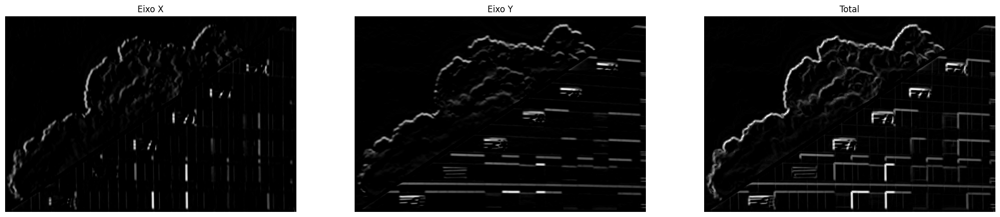

In [ ]:
imagem_media3 = cv2.blur(imgGrey3, (5, 5))
prewitt_x_media = cv2.filter2D(imagem_media3, -1, np.array([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]]))
prewitt_y_media = cv2.filter2D(imagem_media3, -1, np.array([[-1, -1, -1], [0, 0, 0], [1, 1, 1]]))
prewittx_media = np.uint8(np.absolute(prewitt_x_media))
prewitty_media = np.uint8(np.absolute(prewitt_y_media))
imagem_prewitt_media3 = cv2.bitwise_or(prewittx_media, prewitty_media)


'''cv2_imshow(prewitt_x_media)
cv2_imshow(prewitt_y_media)
cv2_imshow(imagem_prewitt_media3)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(prewitt_x_media, cmap='gray', vmin=0, vmax=255)
axes[0].set_title('Eixo X')
axes[1].imshow(prewitt_y_media, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_prewitt_media3, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

#### Método Laplaciano

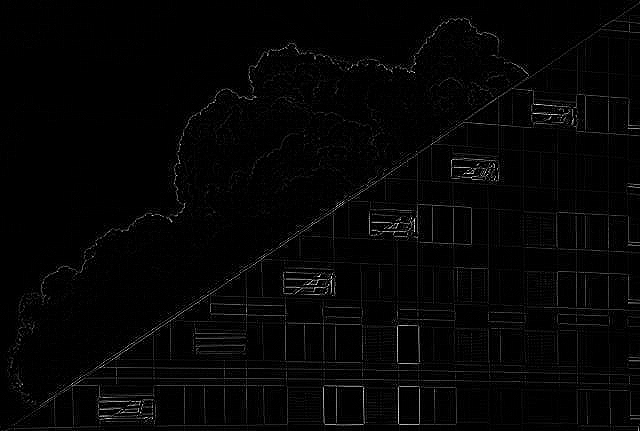

In [ ]:
imagem_laplaciano3 = cv2.Laplacian(imgGrey3, cv2.CV_64F)
#cv2_imshow(imagem_laplaciano3)

Filtro da média

In [ ]:
imagem_media3 = cv2.blur(imgGrey3, (5, 5))
imagem_laplaciano_media3 = cv2.Laplacian(imagem_media3, cv2.CV_64F)
#cv2_imshow(imagem_laplaciano_media3)

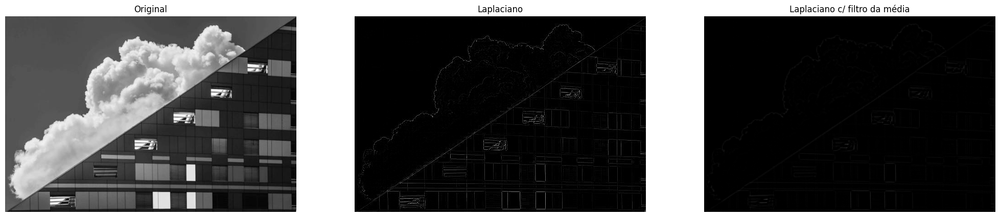

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(imgGrey3, cmap='gray')
axes[0].set_title('Original')
axes[1].imshow(imagem_laplaciano3, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Laplaciano')
axes[2].imshow(imagem_laplaciano_media3, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Laplaciano c/ filtro da média')
for ax in axes:
    ax.axis('off')

plt.show()

#### Método Canny

In [ ]:
imagem_canny3 = cv2.Canny(imgGrey3, 40, 70)
#cv2_imshow(imagem_canny3)

Filtro da média

In [ ]:
imagem_media3 = cv2.blur(imgGrey3, (5, 5))

imagem_canny_media3 = cv2.Canny(imagem_media3, 40, 70)
#cv2_imshow(imagem_canny_media3)

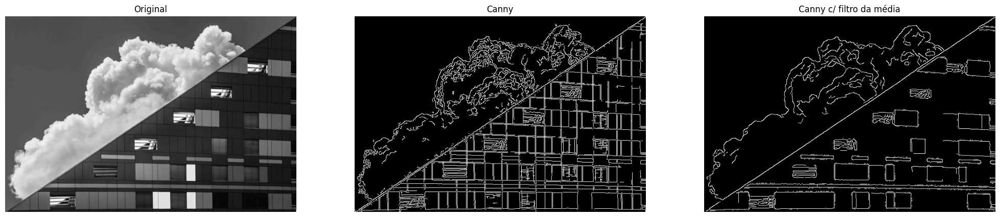

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(imgGrey3, cmap='gray')
axes[0].set_title('Original')
axes[1].imshow(imagem_canny3, cmap='gray')
axes[1].set_title('Canny')
axes[2].imshow(imagem_canny_media3, cmap='gray')
axes[2].set_title('Canny c/ filtro da média')
for ax in axes:
    ax.axis('off')

plt.show()

### Imagem 4

#### Método Sobel

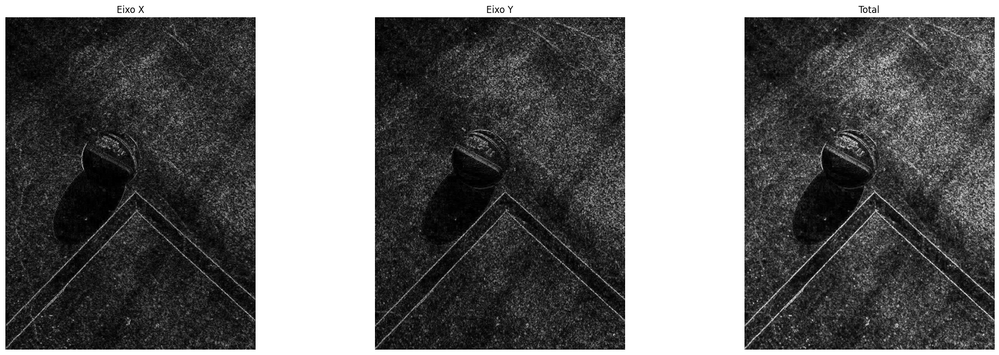

In [ ]:
sobel_x = cv2.Sobel(imgGrey4, cv2.CV_64F, 1, 0, ksize=3)
sobel_y = cv2.Sobel(imgGrey4, cv2.CV_64F, 0, 1, ksize=3)
sobelx = np.uint8(np.absolute(sobel_x))
sobely = np.uint8(np.absolute(sobel_y))
imagem_sobel4 = cv2.bitwise_or(sobelx, sobely)

'''cv2_imshow(sobel_x)
cv2_imshow(sobel_y)
cv2_imshow(imagem_sobel4)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(sobelx, cmap='gray')
axes[0].set_title('Eixo X')
axes[1].imshow(sobely, cmap='gray')
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_sobel4, cmap='gray')
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

Filtro da média

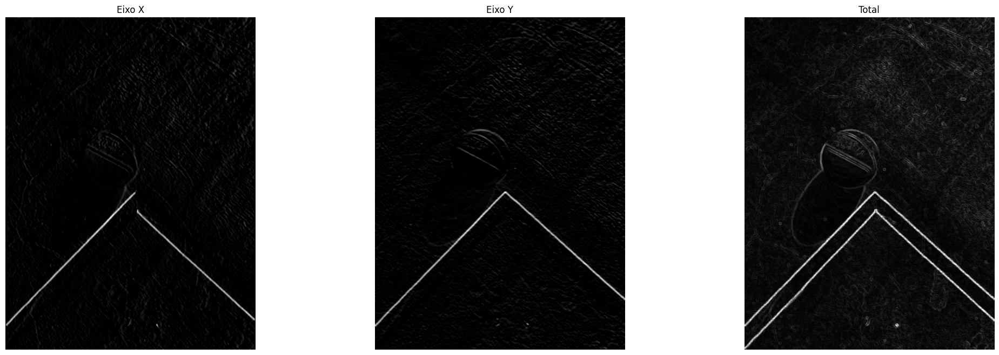

In [ ]:
imagem_media4 = cv2.blur(imgGrey4, (5, 5))

sobel_x_media = cv2.Sobel(imagem_media4, cv2.CV_64F, 1, 0, ksize=3)
sobel_y_media = cv2.Sobel(imagem_media4, cv2.CV_64F, 0, 1, ksize=3)
sobelx_media = np.uint8(np.absolute(sobel_x_media))
sobely_media = np.uint8(np.absolute(sobel_y_media))
imagem_sobel_media4 = cv2.bitwise_or(sobelx_media, sobely_media)

''' cv2_imshow(sobel_x_media)
cv2_imshow(sobel_y_media)
cv2_imshow(imagem_sobel_media4) '''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(sobel_x_media, cmap='gray', vmin=0, vmax=255)
axes[0].set_title('Eixo X')
axes[1].imshow(sobel_y_media, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_sobel_media4, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

#### Método Robert

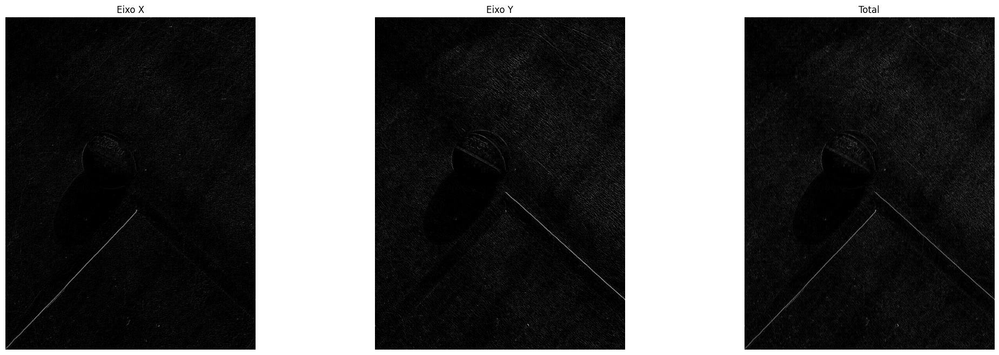

In [ ]:
roberts_x_1 = np.array([[1, 0], [0, -1]])
roberts_y_1 = np.array([[0, -1], [1, 0]])

roberts_x = cv2.filter2D(imgGrey4, -1, roberts_x_1)
roberts_y = cv2.filter2D(imgGrey4, -1, roberts_y_1)
robertsx = np.uint8(np.absolute(roberts_x))
robertsy= np.uint8(np.absolute(roberts_y))
imagem_roberts4 = cv2.bitwise_or(robertsx, robertsy)

'''cv2_imshow(roberts_x)
cv2_imshow(roberts_y)
cv2_imshow(imagem_roberts4)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(robertsx, cmap='gray')
axes[0].set_title('Eixo X')
axes[1].imshow(robertsy, cmap='gray')
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_roberts4, cmap='gray')
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

Filtro da média

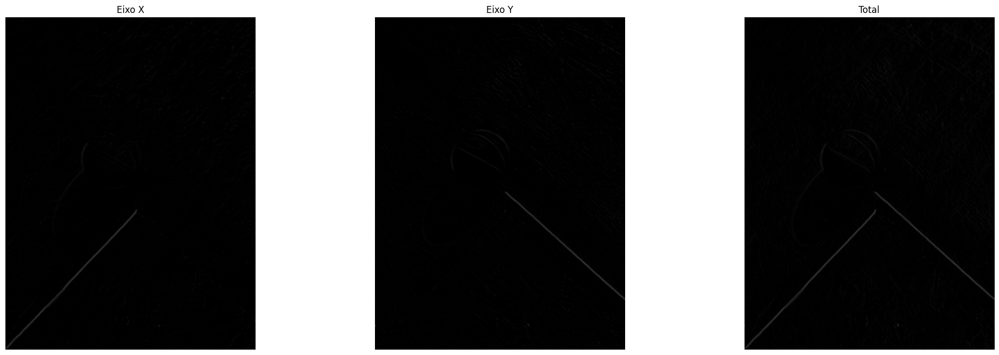

In [ ]:
imagem_media4 = cv2.blur(imgGrey4, (5, 5))
roberts_x_media = cv2.filter2D(imagem_media4, -1, roberts_x_1)
roberts_y_media = cv2.filter2D(imagem_media4, -1, roberts_y_1)
robertsx_media = np.uint8(np.absolute(roberts_x_media))
robertsy_media= np.uint8(np.absolute(roberts_y_media))
imagem_roberts_media4 = cv2.bitwise_or(robertsx_media, robertsy_media)


'''cv2_imshow(roberts_x_media)
cv2_imshow(roberts_y_media)
cv2_imshow(imagem_roberts_media4)'''

fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(roberts_x_media, cmap='gray', vmin=0, vmax=255)
axes[0].set_title('Eixo X')
axes[1].imshow(roberts_y_media, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Eixo Y')
axes[2].imshow(imagem_roberts_media4, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Total')
for ax in axes:
    ax.axis('off')

plt.show()

#### Método Prewit

Filtro da média

#### Método Laplaciano

In [ ]:
imagem_laplaciano4 = cv2.Laplacian(imgGrey4, cv2.CV_64F)
#cv2_imshow(imagem_laplaciano4)

Filtro da média

In [ ]:
imagem_media4 = cv2.blur(imgGrey4, (5, 5))
imagem_laplaciano_media4 = cv2.Laplacian(imagem_media4, cv2.CV_64F)
#cv2_imshow(imagem_laplaciano_media4)

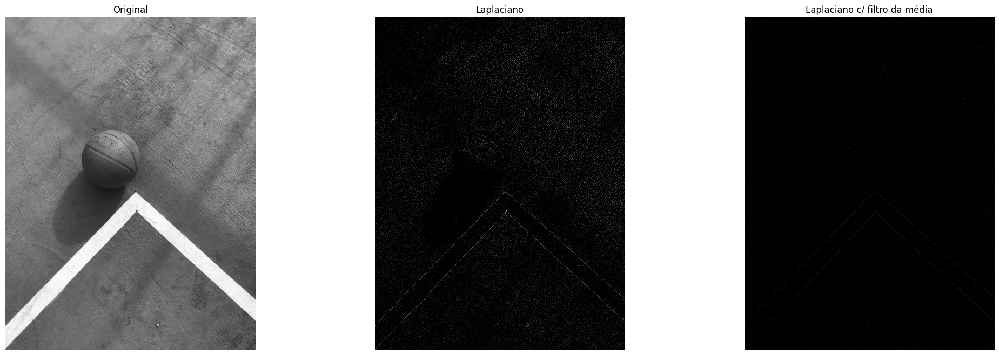

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(imgGrey4, cmap='gray')
axes[0].set_title('Original')
axes[1].imshow(imagem_laplaciano4, cmap='gray', vmin=0, vmax=255)
axes[1].set_title('Laplaciano')
axes[2].imshow(imagem_laplaciano_media4, cmap='gray', vmin=0, vmax=255)
axes[2].set_title('Laplaciano c/ filtro da média')
for ax in axes:
    ax.axis('off')

plt.show()

#### Método Canny

In [ ]:
imagem_canny4 = cv2.Canny(imgGrey4, 50,200)
#cv2_imshow(imagem_canny4)

Filtro da média

In [ ]:
imagem_media4 = cv2.blur(imgGrey4, (5, 5))

imagem_canny_media4 = cv2.Canny(imagem_media4, 50,200)
#cv2_imshow(imagem_canny_media4)

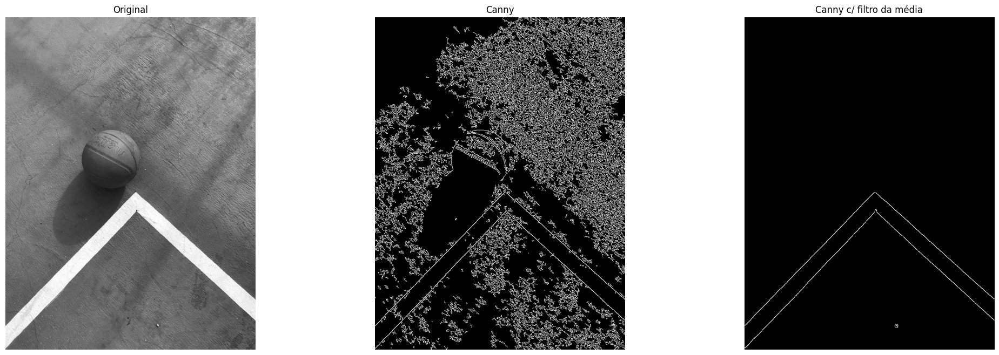

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(imgGrey4, cmap='gray')
axes[0].set_title('Original')
axes[1].imshow(imagem_canny4, cmap='gray')
axes[1].set_title('Canny')
axes[2].imshow(imagem_canny_media4, cmap='gray')
axes[2].set_title('Canny c/ filtro da média')
for ax in axes:
    ax.axis('off')

plt.show()

## 2- Procurar uma outra técnica para identificação de bordas, usando filtro da média e sem o filtro da média

Método Laplaciano de Gaussiano (LoG)


Técnica de detecção de bordas que combina a suavização da imagem com um filtro gaussiano seguido pela aplicação do operador Laplaciano. Isso ajuda a reduzir o impacto do ruído na detecção de bordas, resultando em bordas mais nítidas e precisas.





In [53]:
from scipy.ndimage import gaussian_laplace

##### Imagem 1

In [ ]:
imagem_LG = gaussian_laplace(imgGrey1, sigma=1.0)
#cv2_imshow(imagem_LG)

Filtro da Média

In [ ]:
imagem_LG_media = gaussian_laplace(imagem_media, sigma=1.0)
#cv2_imshow(imagem_LG_media)

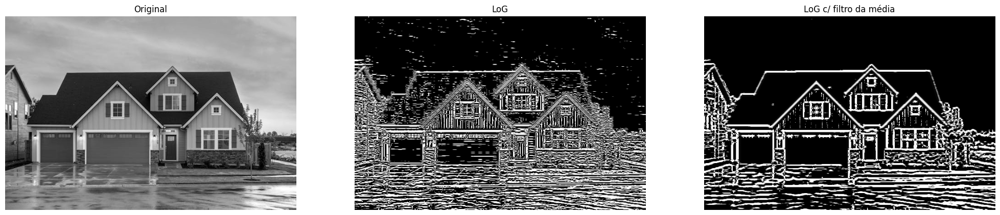

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(imgGrey1, cmap='gray')
axes[0].set_title('Original')
axes[1].imshow(imagem_LG, cmap='gray')
axes[1].set_title('LoG')
axes[2].imshow(imagem_LG_media, cmap='gray')
axes[2].set_title('LoG c/ filtro da média')
for ax in axes:
    ax.axis('off')

plt.show()

##### Imagem 2

In [ ]:
imagem_LG2 = gaussian_laplace(imgGrey2, sigma=1.0)
#cv2_imshow(imagem_LG)

Filtro da Média

In [ ]:
imagem_LG_media2 = gaussian_laplace(imagem_media2, sigma=1.0)
#cv2_imshow(imagem_LG_media)

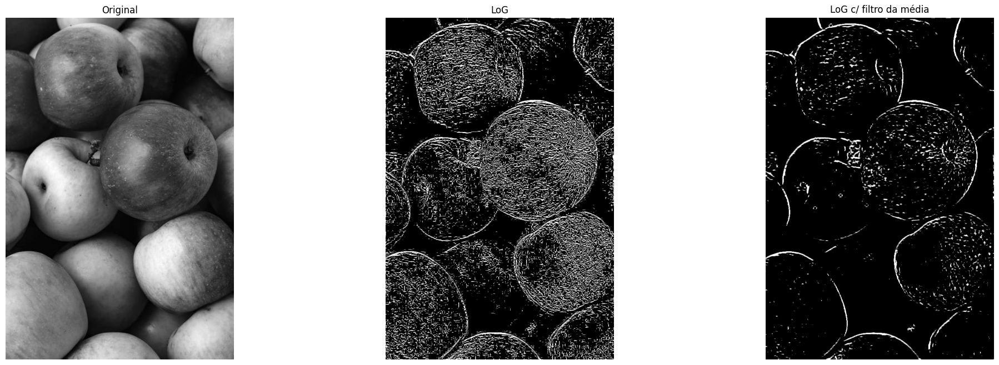

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(imgGrey2, cmap='gray')
axes[0].set_title('Original')
axes[1].imshow(imagem_LG2, cmap='gray')
axes[1].set_title('LoG')
axes[2].imshow(imagem_LG_media2, cmap='gray')
axes[2].set_title('LoG c/ filtro da média')
for ax in axes:
    ax.axis('off')

plt.show()

#### Imagem 3

In [ ]:
imagem_LG3 = gaussian_laplace(imgGrey3, sigma=1.0)
#cv2_imshow(imagem_LG)

Filtro da Média

In [ ]:
imagem_LG_media3 = gaussian_laplace(imagem_media3, sigma=1.0)
#cv2_imshow(imagem_LG_media)

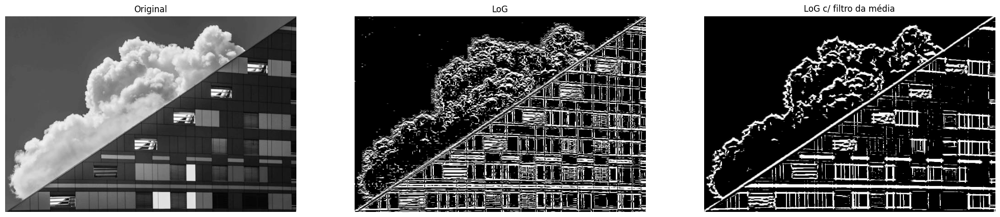

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(imgGrey3, cmap='gray')
axes[0].set_title('Original')
axes[1].imshow(imagem_LG3, cmap='gray')
axes[1].set_title('LoG')
axes[2].imshow(imagem_LG_media3, cmap='gray')
axes[2].set_title('LoG c/ filtro da média')
for ax in axes:
    ax.axis('off')

plt.show()

#### Imagem 4

In [ ]:
imagem_LG4 = gaussian_laplace(imgGrey4, sigma=1.0)
#cv2_imshow(imagem_LG)

Filtro da Média

In [ ]:
imagem_LG_media4 = gaussian_laplace(imagem_media4, sigma=1.0)
#cv2_imshow(imagem_LG_media)

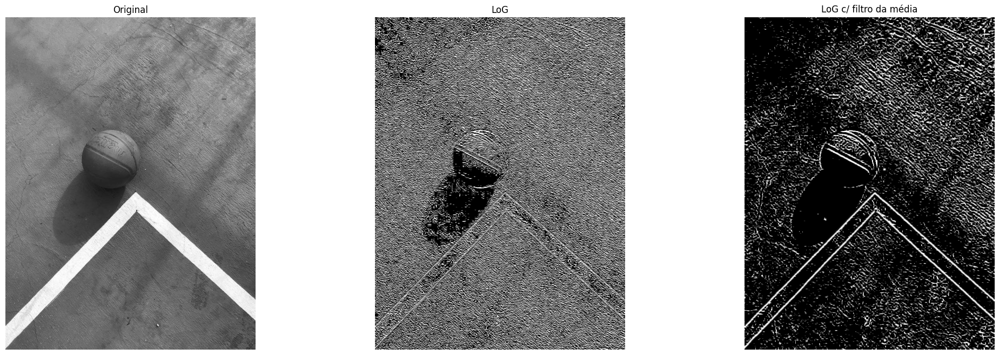

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(25, 8))
axes[0].imshow(imgGrey4, cmap='gray')
axes[0].set_title('Original')
axes[1].imshow(imagem_LG4, cmap='gray')
axes[1].set_title('LoG')
axes[2].imshow(imagem_LG_media4, cmap='gray')
axes[2].set_title('LoG c/ filtro da média')
for ax in axes:
    ax.axis('off')

plt.show()

## 3 - Usar K-Means para identificar os objetos das imagens, dependendo use técnicas já apresentadas

In [10]:
import numpy as np
from IPython.display import Image
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import KMeans

#### Imagem 1

In [48]:
img = cv2.cvtColor(imag_1, cv2.COLOR_BGR2RGB)
r, g, b = cv2.split(img)
r = r.flatten()
g = g.flatten()
b = b.flatten()

In [62]:
fig = plt.figure()
ax = Axes3D(fig)
ax.scatter(r, g, b)
plt.show()

<Figure size 640x480 with 0 Axes>

In [61]:
vectorized = img.reshape((-1,3))
vectorized = np.float32(vectorized)
print(vectorized.shape)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2)

(273280, 3)


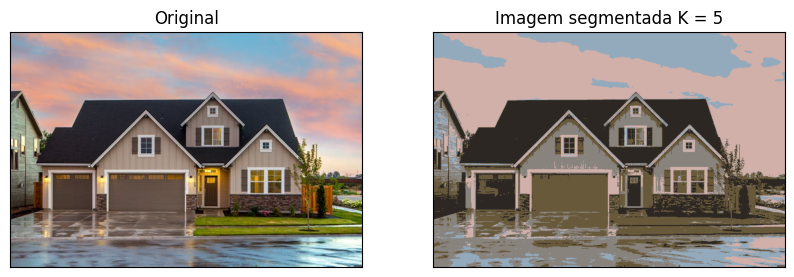

In [63]:
K=5
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_RANDOM_CENTERS)
label = label.flatten()
center = np.uint8(center)
res = center[label.flatten()]
result_image = res.reshape((img.shape))

figure_size = 10
plt.figure(figsize=(figure_size,figure_size))
plt.subplot(1, 2, 1),plt.imshow(img)
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(1, 2, 2),plt.imshow(result_image)
plt.title('Imagem segmentada K = %i' % K), plt.xticks([]), plt.yticks([])
plt.show()

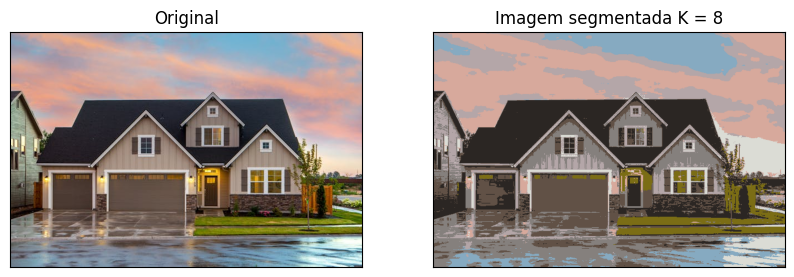

In [64]:
K=8
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_RANDOM_CENTERS)
label = label.flatten()
center = np.uint8(center)
res = center[label.flatten()]
result_image = res.reshape((img.shape))
figure_size = 10
plt.figure(figsize=(figure_size,figure_size))
plt.subplot(1, 2, 1),plt.imshow(img)
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(1, 2, 2),plt.imshow(result_image)
plt.title('Imagem segmentada K = %i' % K), plt.xticks([]), plt.yticks([])
plt.show()

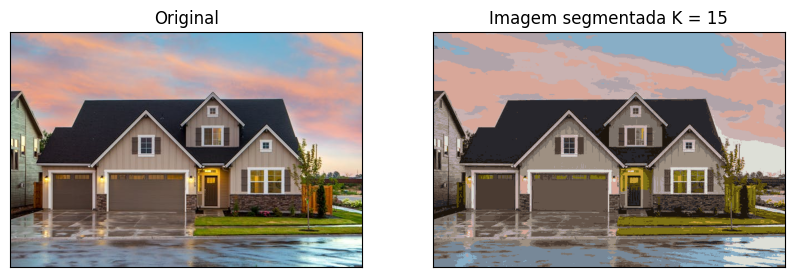

In [65]:
K=15
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_RANDOM_CENTERS)
label = label.flatten()
center = np.uint8(center)
res = center[label.flatten()]
result_image = res.reshape((img.shape))

figure_size = 10
plt.figure(figsize=(figure_size,figure_size))
plt.subplot(1, 2, 1),plt.imshow(img)
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(1, 2, 2),plt.imshow(result_image)
plt.title('Imagem segmentada K = %i' % K), plt.xticks([]), plt.yticks([])
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


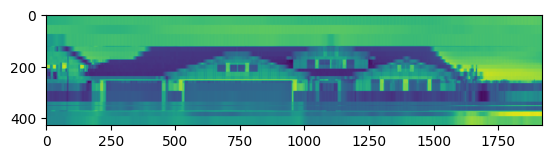

In [ ]:
pic = np.float64(img/256)
nsamples, nx, ny = pic.shape
pic1 = pic.reshape((nsamples,nx*ny))
kmeans = KMeans(n_clusters=20, random_state=0).fit(pic1)
pic2show = kmeans.cluster_centers_[kmeans.labels_]
plt.imshow(pic2show)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


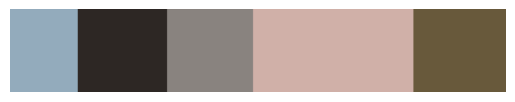

In [ ]:
image = cv2.cvtColor(imag_1, cv2.COLOR_BGR2RGB)
image = image.reshape((image.shape[0] * image.shape[1], 3))
clt = KMeans(n_clusters = 5)
clt.fit(image)
def centroid_histogram(clt):
	numLabels = np.arange(0, len(np.unique(clt.labels_)) + 1)
	(hist, _) = np.histogram(clt.labels_, bins = numLabels)
	hist = hist.astype("float")
	hist /= hist.sum()
	return hist

def plot_colors(hist, centroids):
	bar = np.zeros((50, 300, 3), dtype = "uint8")
	startX = 0
	for (percent, color) in zip(hist, centroids):
		endX = startX + (percent * 300)
		cv2.rectangle(bar, (int(startX), 0), (int(endX), 50),
			color.astype("uint8").tolist(), -1)
		startX = endX
	return bar

hist = centroid_histogram(clt)
bar = plot_colors(hist, clt.cluster_centers_)
plt.figure()
plt.axis("off")
plt.imshow(bar)
plt.show()

#### Imagem 2

In [77]:
img2 = cv2.cvtColor(imag_2, cv2.COLOR_BGR2RGB)
r, g, b = cv2.split(img2)
r = r.flatten()
g = g.flatten()
b = b.flatten()

vectorized = img2.reshape((-1,3))
vectorized = np.float32(vectorized)
print(vectorized.shape)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2)

(614400, 3)


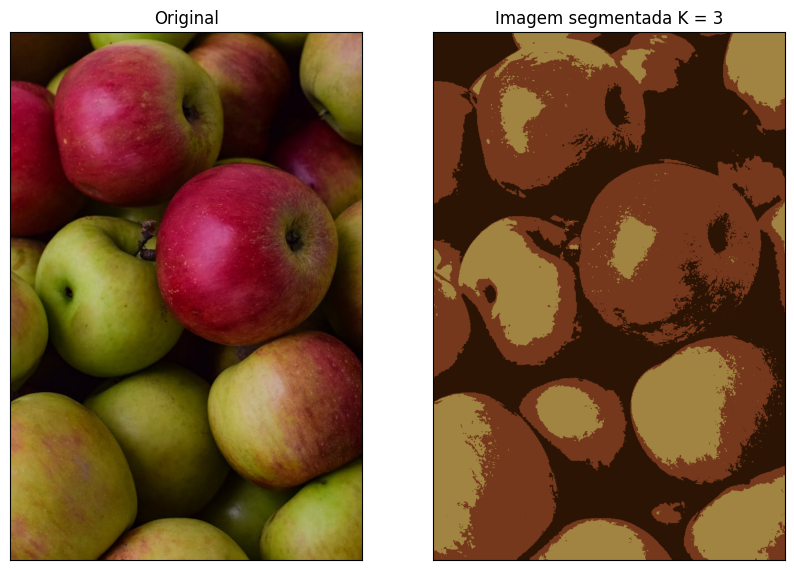

In [78]:
K=3
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_RANDOM_CENTERS)
label = label.flatten()
center = np.uint8(center)
res = center[label.flatten()]
result_image = res.reshape((img2.shape))

figure_size = 10
plt.figure(figsize=(figure_size,figure_size))
plt.subplot(1, 2, 1),plt.imshow(img2)
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(1, 2, 2),plt.imshow(result_image)
plt.title('Imagem segmentada K = %i' % K), plt.xticks([]), plt.yticks([])
plt.show()

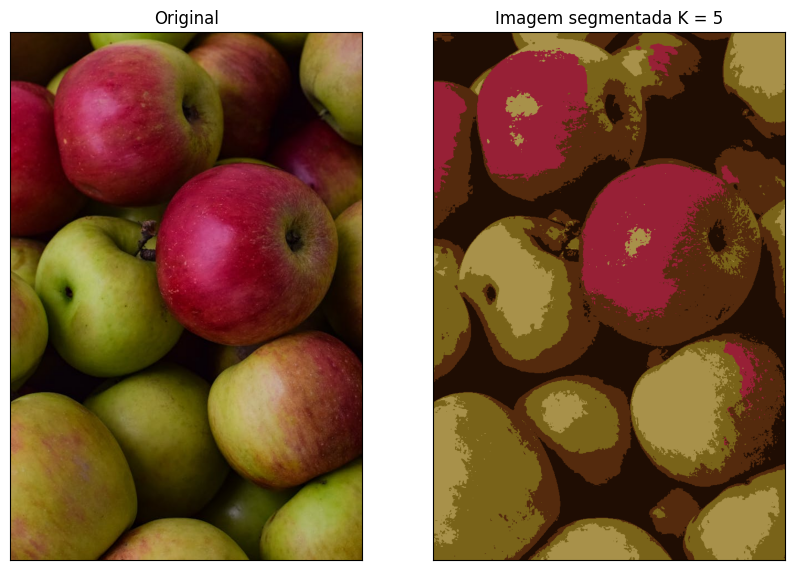

In [79]:
K=5
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_RANDOM_CENTERS)
label = label.flatten()
center = np.uint8(center)
res = center[label.flatten()]
result_image = res.reshape((img2.shape))
figure_size = 10
plt.figure(figsize=(figure_size,figure_size))
plt.subplot(1, 2, 1),plt.imshow(img2)
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(1, 2, 2),plt.imshow(result_image)
plt.title('Imagem segmentada K = %i' % K), plt.xticks([]), plt.yticks([])
plt.show()

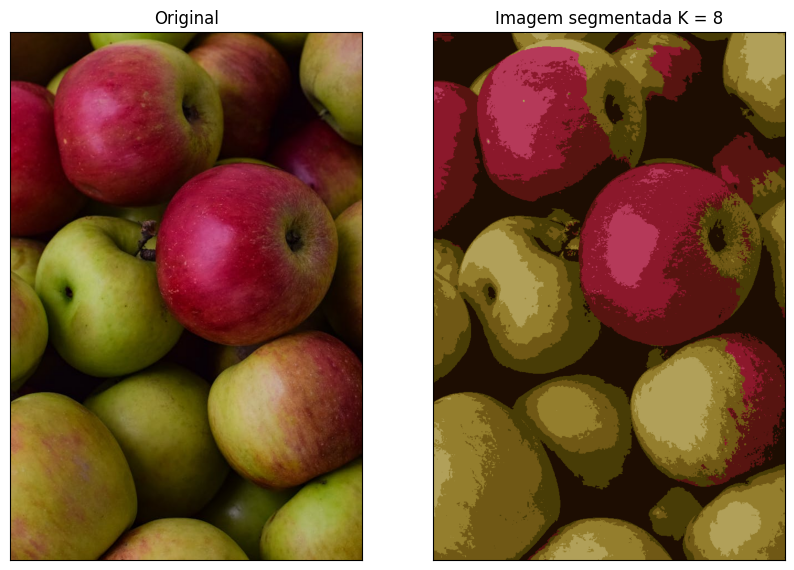

In [80]:
K=8
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_RANDOM_CENTERS)
label = label.flatten()
center = np.uint8(center)
res = center[label.flatten()]
result_image = res.reshape((img2.shape))
figure_size = 10
plt.figure(figsize=(figure_size,figure_size))
plt.subplot(1, 2, 1),plt.imshow(img2)
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(1, 2, 2),plt.imshow(result_image)
plt.title('Imagem segmentada K = %i' % K), plt.xticks([]), plt.yticks([])
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


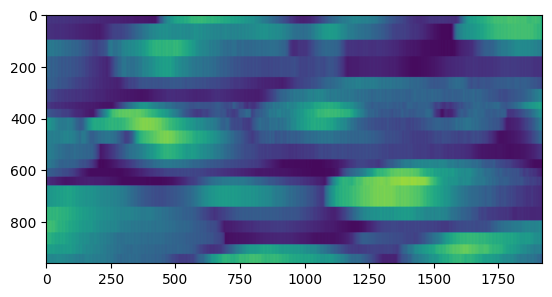

In [91]:
pic = np.float64(img2/256)
nsamples, nx, ny = pic.shape
pic1 = pic.reshape((nsamples,nx*ny))
kmeans = KMeans(n_clusters=20, random_state=0).fit(pic1)
pic2show = kmeans.cluster_centers_[kmeans.labels_]
plt.imshow(pic2show, origin='upper')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


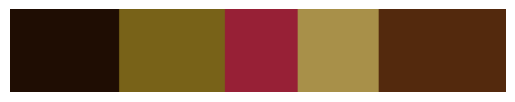

In [86]:
image = cv2.cvtColor(imag_2, cv2.COLOR_BGR2RGB)
image = image.reshape((image.shape[0] * image.shape[1], 3))
clt = KMeans(n_clusters = 5)
clt.fit(image)
def centroid_histogram(clt):
	numLabels = np.arange(0, len(np.unique(clt.labels_)) + 1)
	(hist, _) = np.histogram(clt.labels_, bins = numLabels)
	hist = hist.astype("float")
	hist /= hist.sum()
	return hist

def plot_colors(hist, centroids):
	bar = np.zeros((50, 300, 3), dtype = "uint8")
	startX = 0
	for (percent, color) in zip(hist, centroids):
		endX = startX + (percent * 300)
		cv2.rectangle(bar, (int(startX), 0), (int(endX), 50),
			color.astype("uint8").tolist(), -1)
		startX = endX
	return bar

hist = centroid_histogram(clt)
bar = plot_colors(hist, clt.cluster_centers_)
plt.figure()
plt.axis("off")
plt.imshow(bar)
plt.show()

#### Imagem 3

In [16]:
filepath ="/content/drive/MyDrive/PIM/ATVD05/imag3.jpg"

img = cv2.imread(filepath)
img3= cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
r, g, b = cv2.split(img3)
r = r.flatten()
g = g.flatten()
b = b.flatten()

In [17]:
vectorized = img3.reshape((-1,3))
vectorized = np.float32(vectorized)
print(vectorized.shape)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2)

(275840, 3)


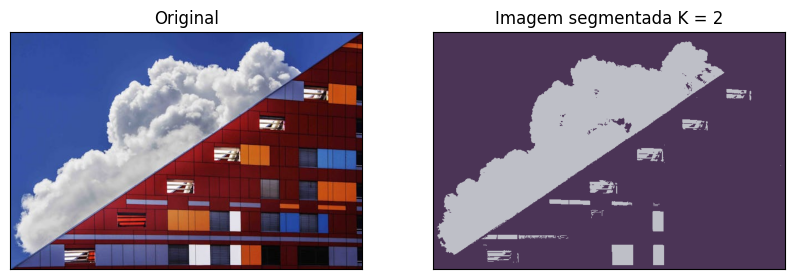

In [25]:
K=2
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_RANDOM_CENTERS)
label = label.flatten()
center = np.uint8(center)
res = center[label.flatten()]
result_image = res.reshape((img3.shape))

figure_size = 10
plt.figure(figsize=(figure_size,figure_size))
plt.subplot(1, 2, 1),plt.imshow(img3)
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(1, 2, 2),plt.imshow(result_image)
plt.title('Imagem segmentada K = %i' % K), plt.xticks([]), plt.yticks([])
plt.show()

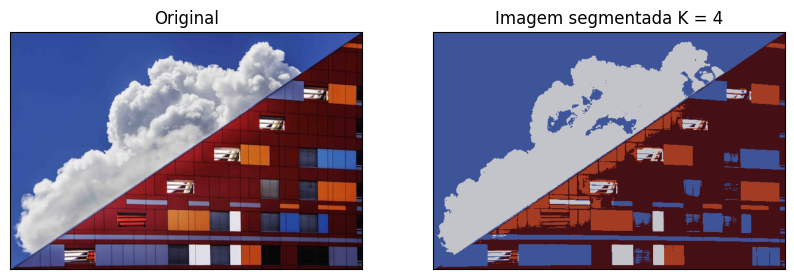

In [26]:
K=4
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_RANDOM_CENTERS)
label = label.flatten()
center = np.uint8(center)
res = center[label.flatten()]
result_image = res.reshape((img3.shape))

figure_size = 10
plt.figure(figsize=(figure_size,figure_size))
plt.subplot(1, 2, 1),plt.imshow(img3)
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(1, 2, 2),plt.imshow(result_image)
plt.title('Imagem segmentada K = %i' % K), plt.xticks([]), plt.yticks([])
plt.show()

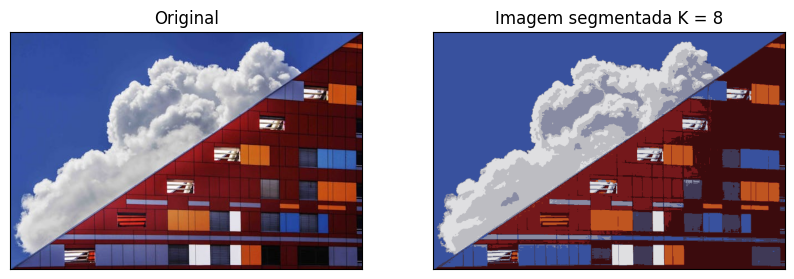

In [20]:
K=8
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_RANDOM_CENTERS)
label = label.flatten()
center = np.uint8(center)
res = center[label.flatten()]
result_image = res.reshape((img3.shape))

figure_size = 10
plt.figure(figsize=(figure_size,figure_size))
plt.subplot(1, 2, 1),plt.imshow(img3)
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(1, 2, 2),plt.imshow(result_image)
plt.title('Imagem segmentada K = %i' % K), plt.xticks([]), plt.yticks([])
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


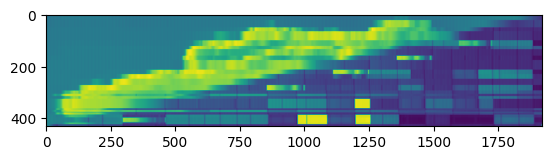

In [21]:
pic = np.float64(img3/256)
nsamples, nx, ny = pic.shape
pic1 = pic.reshape((nsamples,nx*ny))
kmeans = KMeans(n_clusters=20, random_state=0).fit(pic1)
pic2show = kmeans.cluster_centers_[kmeans.labels_]
plt.imshow(pic2show, origin='upper')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


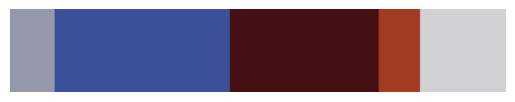

In [23]:
image = cv2.cvtColor(imag_3, cv2.COLOR_BGR2RGB)
image = image.reshape((image.shape[0] * image.shape[1], 3))
clt = KMeans(n_clusters = 5)
clt.fit(image)
def centroid_histogram(clt):
	numLabels = np.arange(0, len(np.unique(clt.labels_)) + 1)
	(hist, _) = np.histogram(clt.labels_, bins = numLabels)
	hist = hist.astype("float")
	hist /= hist.sum()
	return hist

def plot_colors(hist, centroids):
	bar = np.zeros((50, 300, 3), dtype = "uint8")
	startX = 0
	for (percent, color) in zip(hist, centroids):
		endX = startX + (percent * 300)
		cv2.rectangle(bar, (int(startX), 0), (int(endX), 50),
			color.astype("uint8").tolist(), -1)
		startX = endX
	return bar

hist = centroid_histogram(clt)
bar = plot_colors(hist, clt.cluster_centers_)
plt.figure()
plt.axis("off")
plt.imshow(bar)
plt.show()

#### Imagem 4

In [6]:
filepath ="/content/drive/MyDrive/PIM/ATVD05/imag4.jpg"

img = cv2.imread(filepath)
img4 = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
r, g, b = cv2.split(img4)
r = r.flatten()
g = g.flatten()
b = b.flatten()

In [8]:
vectorized = img4.reshape((-1,3))
vectorized = np.float32(vectorized)
print(vectorized.shape)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2)

(545920, 3)


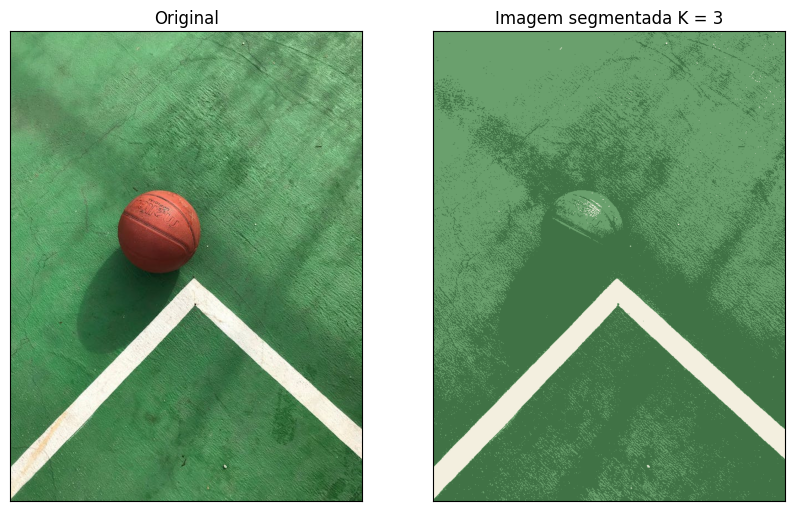

In [9]:
K=3
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_RANDOM_CENTERS)
label = label.flatten()
center = np.uint8(center)
res = center[label.flatten()]
result_image = res.reshape((img4.shape))

figure_size = 10
plt.figure(figsize=(figure_size,figure_size))
plt.subplot(1, 2, 1),plt.imshow(img4)
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(1, 2, 2),plt.imshow(result_image)
plt.title('Imagem segmentada K = %i' % K), plt.xticks([]), plt.yticks([])
plt.show()

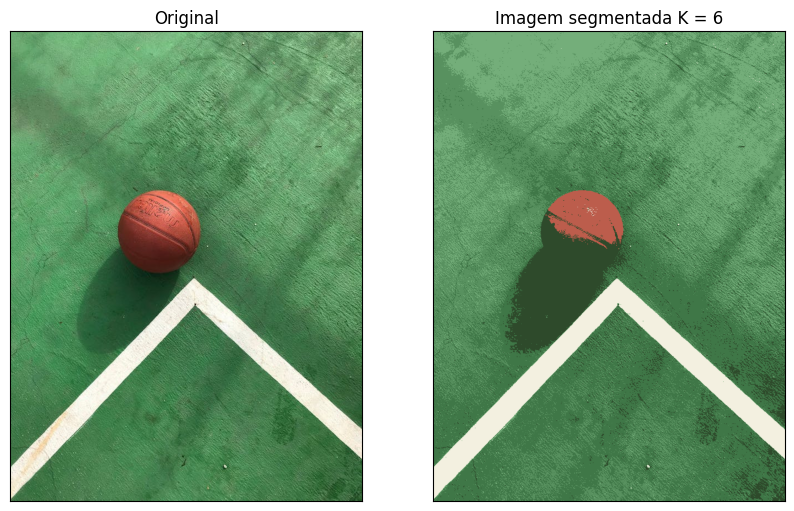

In [12]:
K=6
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_RANDOM_CENTERS)
label = label.flatten()
center = np.uint8(center)
res = center[label.flatten()]
result_image = res.reshape((img4.shape))

figure_size = 10
plt.figure(figsize=(figure_size,figure_size))
plt.subplot(1, 2, 1),plt.imshow(img4)
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(1, 2, 2),plt.imshow(result_image)
plt.title('Imagem segmentada K = %i' % K), plt.xticks([]), plt.yticks([])
plt.show()

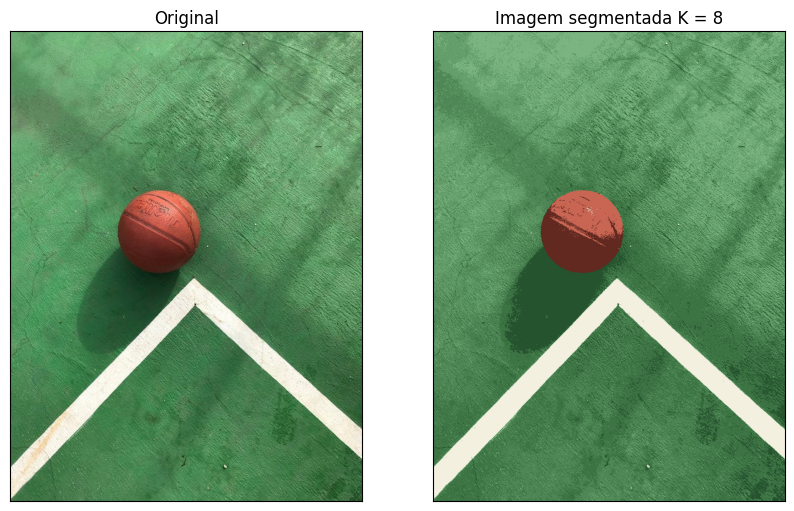

In [13]:
K=8
attempts=10
ret,label,center=cv2.kmeans(vectorized,K,None,criteria,attempts,cv2.KMEANS_RANDOM_CENTERS)
label = label.flatten()
center = np.uint8(center)
res = center[label.flatten()]
result_image = res.reshape((img4.shape))

figure_size = 10
plt.figure(figsize=(figure_size,figure_size))
plt.subplot(1, 2, 1),plt.imshow(img4)
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(1, 2, 2),plt.imshow(result_image)
plt.title('Imagem segmentada K = %i' % K), plt.xticks([]), plt.yticks([])
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


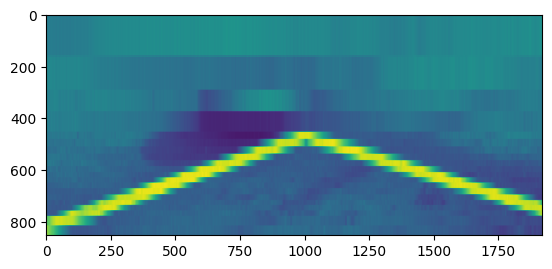

In [14]:
pic = np.float64(img4/256)
nsamples, nx, ny = pic.shape
pic1 = pic.reshape((nsamples,nx*ny))
kmeans = KMeans(n_clusters=20, random_state=0).fit(pic1)
pic2show = kmeans.cluster_centers_[kmeans.labels_]
plt.imshow(pic2show, origin='upper')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


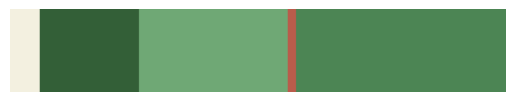

In [15]:
image = cv2.cvtColor(imag_4, cv2.COLOR_BGR2RGB)
image = image.reshape((image.shape[0] * image.shape[1], 3))
clt = KMeans(n_clusters = 5)
clt.fit(image)
def centroid_histogram(clt):
	numLabels = np.arange(0, len(np.unique(clt.labels_)) + 1)
	(hist, _) = np.histogram(clt.labels_, bins = numLabels)
	hist = hist.astype("float")
	hist /= hist.sum()
	return hist

def plot_colors(hist, centroids):
	bar = np.zeros((50, 300, 3), dtype = "uint8")
	startX = 0
	for (percent, color) in zip(hist, centroids):
		endX = startX + (percent * 300)
		cv2.rectangle(bar, (int(startX), 0), (int(endX), 50),
			color.astype("uint8").tolist(), -1)
		startX = endX
	return bar

hist = centroid_histogram(clt)
bar = plot_colors(hist, clt.cluster_centers_)
plt.figure()
plt.axis("off")
plt.imshow(bar)
plt.show()